In [1]:
import warnings
warnings.filterwarnings('ignore')

In [2]:
import pandas as pd
import os
import matplotlib.pyplot as plt
#from holidays import country_holidays
import holidays
import itertools
import numpy as np
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.seasonal import STL
import seaborn as sns
import scipy.stats as stats
import interpret
import pyod
from pyod.models.knn import KNN
from pyod.models.lof import LOF
from pyod.models.iforest import IForest
from pyod.models.ecod import ECOD
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.compose import make_column_transformer
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
import math 
from sktime.forecasting.ets import AutoETS
from sktime.utils.plotting import plot_series
from sktime.forecasting.arima import AutoARIMA
from interpret.glassbox import ExplainableBoostingRegressor
from sktime.forecasting.base import ForecastingHorizon
from sktime.forecasting.tbats import TBATS
from sktime.performance_metrics.forecasting import make_forecasting_scorer
from sktime.forecasting.naive import NaiveForecaster

%matplotlib inline

In [3]:
def interpretable_scores(y_true, y_pred, debug_printing = False):
    """ 
        
    Score function based on the business goals.
    
    inputs have to be np arrays.
    
    calculates two losses based on the business goals.
    
    first goal: 
    loss is the percent difference in activated sby drivers
    
    values over 100 % drivers activated need to be capped to 100% or penalized.
    otherwise, underpredicting would be beneficial.
    
    first, I calculate a loss_1 where I decided to cap the value for the percentage of activated drivers to 100.
    thereby, the magnitude of underpredicting will not be penalized. 
    instead, the loss is the literal efficiency of sby driver activation.
    importantly, this will give you a positive loss in the following example:
    true: 100, benchmark: 90, pred: 110.
    both the benchmark and the pred are off by 10, 
    but you've lost efficiency by overpredicting!
    
   
    second goal:
    count delta of number of occasions on which additional sby drivers 
    have to be recruited.
    
    furthermore, the magnitude of underpredictions is calculated to judge whether
    the model under investigation is getting closer to the true value when underpredicting 
    than the baseline. 

    """
    import math
    
        
    #################
    # 1. goal
    #################
    
    # compare the mean percentage of sby drivers being activated.
    benchmark_sby_activated = (1 - (90 - y_true) / 90) * 100
    pred_sby_activated = np.where(y_pred!=0,  (1 - (y_pred - y_true) / y_pred) * 100, 100)
    
    if debug_printing == True:
        print("1st goal: efficiency of sby driver activation")
        print(f"benchmark_sby_activated: {benchmark_sby_activated}")
        print(f"pred_sby_activated: {pred_sby_activated}")
        
    #cap the % activation to 100.
    benchmark_sby_activated[benchmark_sby_activated > 100] = 100
    pred_sby_activated[pred_sby_activated > 100] = 100
    
    if debug_printing == True:
        print("after capping:")
        print(f"benchmark_sby_activated: {benchmark_sby_activated}")
        print(f"pred_sby_activated: {pred_sby_activated}")
    
    #unpenalized efficiency score
    avg_benchmark_sby_activated = np.mean(benchmark_sby_activated)
    avg_pred_sby_activated = np.mean(pred_sby_activated)  
    
    # if the difference is < 0 we are meeting business goals
    loss_1 = avg_benchmark_sby_activated - avg_pred_sby_activated

    if debug_printing == True:
        print("averages:")
        print(f"benchmark_sby_activated: {avg_benchmark_sby_activated}")
        print(f"pred_sby_activated: {avg_pred_sby_activated}")
        print(f"On average, the prediction is {loss_1} % less efficient.")

    #################
    # 2. goal
    #################
    
    num_times_benchmark_undershoots = np.count_nonzero(y_true > 90)
    num_times_pred_undershoots = np.count_nonzero(y_true > y_pred)

    # if the difference is y < we are meeting business goals
    loss_2 = num_times_pred_undershoots - num_times_benchmark_undershoots
        
    if debug_printing == True:
        print("\n2nd goal: number of times undershooting")
        print(f"num_times_benchmark_undershoots: {num_times_benchmark_undershoots}")
        print(f"num_times_pred_undershoots: {num_times_pred_undershoots}") 
        print(f"Your predictions undershoot {loss_2} times more often.")
        
    #2. goal: the average magnitude of undershooting, 
    # i.e., the average gap between the preds and the trues
    benchmark_gaps = y_true - 90
    y_pred_gaps = y_true - y_pred
    
    if debug_printing == True:
        print("\n2nd goal: avg number additional drivers required when undershooting")
        print(f"benchmark_gaps: {benchmark_gaps}")
        print(f"y_pred_gaps: {y_pred_gaps}") 
    
    #filter the negative values
    benchmark_gaps = [x for x in benchmark_gaps if x > 0]
    y_pred_gaps = [x for x in y_pred_gaps if x > 0]
    
    if debug_printing == True:
        print("after filtering out values <= 0")
        print(f"benchmark_gaps: {benchmark_gaps}")
        print(f"y_pred_gaps: {y_pred_gaps}") 
    
    #average gap sizes
    avg_benchmark_gaps = np.mean(benchmark_gaps)
    avg_pred_gaps = np.mean(y_pred_gaps) 
    
    # the avg can be nan if there no values,
    # so they're set to 0 here
    if math.isnan(avg_benchmark_gaps):
        avg_benchmark_gaps = 0
    if math.isnan(avg_pred_gaps):
        avg_pred_gaps = 0
    
    #delta: lower is better
    loss_3 = avg_pred_gaps - avg_benchmark_gaps 
            
    if debug_printing == True:
        print(f"avg_benchmark_gaps: {avg_benchmark_gaps}")
        print(f"avg_pred_gaps: {avg_pred_gaps}")
        print(f"On average, {loss_3} additional drivers have to be recruited compared to benchmark when underpredicting.\n")
        
    return loss_1, loss_2, loss_3



In [4]:
def cv_sktime_models_one_year(model, statsforecast_df, splits_dict, custom_scorer, plotting = True,
                     print_per_month = True, print_mean = True, transformer = None, smoothing = None,
                             interval = None):
    """
    function to perform cv for a given model
    
    For some reason, this function always throws the "returning a view versus a copy" warning
    (https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy)
    when rolling windows are calculated or transformers are used.
    I have no clue why they are thrown however, as .loc is used wherever possible.
    the rolling method appears to be correctly implemented as well
    https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.rolling.html
    
    
    """

    from sktime.transformations.series.boxcox import LogTransformer
    from sktime.transformations.series.boxcox import BoxCoxTransformer
    from sktime.forecasting.base import ForecastingHorizon
    
    #init lists to append scores for single months 
    # to calculate average scores for all folds
    efficiency_losses = []
    num_undershoots = []
    magnitude_undershoots = []
    y_pred_list = []
    regressors = []
    
    #plotting
    if plotting == True:
        fig, axes = plt.subplots(6, 2, figsize = (60,60))
        # a counter to get the correct ax object
        i = 0
    
    for split in splits_dict.keys(): 
        
        #extract data from the splits_dict for enhanced readability inside the function
        last_train_day = splits_dict[split]["last_train_day"]
        first_test_day = splits_dict[split]["first_test_day"]
        last_test_day = splits_dict[split]["last_test_day"]
        month = splits_dict[split]["month"]
        leading_days = len(statsforecast_df[(statsforecast_df.ds > last_train_day) &
                                      (statsforecast_df.ds < first_test_day)])
        
        #calculate the length of the forecasting horizon
        horizon = len(statsforecast_df[(statsforecast_df.ds > last_train_day) &
                                      (statsforecast_df.ds <= last_test_day)])  
        
        #extract train and test data
        Y_train_df = statsforecast_df.loc[statsforecast_df.ds <= last_train_day, :]
        Y_test_df = statsforecast_df.loc[(statsforecast_df.ds >= first_test_day) & 
                                    (statsforecast_df.ds <= last_test_day), :]
        
        #print(Y_train_df)
        
        #smooth the data
        if smoothing == "MA_weekly":
            Y_train_df.loc[:, "y"] = Y_train_df.loc[:, "y",].rolling(window = 7, center = True, closed = "both", min_periods = 1).mean()
        elif smoothing == "MA_monthly":
            Y_train_df.loc[:, "y"] = Y_train_df.loc[:, "y",].rolling(window = 31, center = True, closed = "both", min_periods = 1).mean()
        if smoothing == "MA_oneday":
            Y_train_df.loc[:, "y"] = Y_train_df.loc[:, "y",].rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()
        elif smoothing == "EWM_monthly":
            Y_train_df.loc[:, "y"] = Y_train_df.loc[:, "y",].ewm(span = 30, min_periods = 1).mean()
        elif smoothing == "EWM_weekly":
            Y_train_df.loc[:, "y"] = Y_train_df.loc[:, "y",].ewm(span = 7, min_periods = 1).mean()
            
        #print(Y_train_df)
        
        #transform train data
        if transformer == "ln":
            trafo_obj = LogTransformer(offset = 1)#
            Y_train_transformed = trafo_obj.fit_transform(Y_train_df.loc[:, "y"])
            Y_train_df.loc[:, "y"] = Y_train_transformed
        elif transformer == "boxcox":
            # no offset param available. 
            trafo_obj = BoxCoxTransformer()
            Y_train_transformed = trafo_obj.fit_transform(Y_train_df.loc[:, "y"] + 1)
            Y_train_df.loc[:, "y"] = Y_train_transformed 
                
        
        #fit and predict
        model_obj = model
        model_obj.fit(Y_train_df.loc[:, 'y'].values)
        regressors.append(model_obj)
        
        if interval != None:
            Y_hat_df = pd.DataFrame({"y": model_obj.predict_interval(np.arange(leading_days, horizon), 
                                                                    coverage  = interval)["Coverage"][interval]["upper"]})
        else:
            Y_hat_df = pd.DataFrame({"y": model_obj.predict(np.arange(leading_days, horizon)).reshape(1,-1)[0]})
            # some models make negative predictions, so those should be set to zero
        Y_hat_df[Y_hat_df["y"] < 0] = 0
                
        #transform back
        if transformer == "ln":
            Y_train_rev_transformed = trafo_obj.inverse_transform(Y_train_df.loc[:, "y"] )
            Y_train_df.loc[:, "y"] = Y_train_rev_transformed
            Y_hat_rev_transformed = trafo_obj.inverse_transform(Y_hat_df.loc[:, "y"])
            Y_hat_df.loc[:, "y"] = Y_hat_rev_transformed
            
        elif transformer == "boxcox":
            # as there is no offset available when initializing the 
            # transformer object, you have to manually subtract 1
            Y_train_rev_transformed = trafo_obj.inverse_transform(Y_train_df.loc[:, "y"] ) - 1
            Y_train_df.loc[:, "y"] = Y_train_rev_transformed
            Y_hat_rev_transformed = trafo_obj.inverse_transform(Y_hat_df.loc[:, "y"]) - 1
            Y_hat_df.loc[:, "y"] = Y_hat_rev_transformed
        
        #get arrays of the data for metrics        
        y_trues = Y_test_df.loc[:, 'y'].values
        y_preds = Y_hat_df.loc[:, 'y'].values
        
        #calculate metrics
        efficiency_loss, num_undershoots_loss, magnitude_undershoots_loss = custom_scorer(y_trues, y_preds)
        efficiency_losses.append(efficiency_loss)
        num_undershoots.append(num_undershoots_loss)
        magnitude_undershoots.append(magnitude_undershoots_loss)
        y_pred_list.append(y_preds)

        if plotting == True:
        # plotting
            ax = axes.flat[i]
    
            ax.plot(Y_test_df.ds, y_trues, label = "y")
            ax.plot(Y_test_df.ds, y_preds, label = "y_hat")
            ax.set_title(month, size = 20)    
            ax.set_ylabel("Number of standby drivers", size = 20, labelpad = 20)
            ax.tick_params(axis = "x", rotation = 45)  
            ax.axhline(y = 90, xmin = 0, xmax = 1, color = "red",
                label = "current policy: 90 drivers")
            ax.legend()
    
            # iterate the counter for the ax object
            i += 1
        
        if print_per_month == True:                
            print(f"\nSplit for {month}")
            print(f"Forecasting for {str(horizon - leading_days)} days")
            print(f"Number of leading days: {leading_days}")
            print(f"Loss in efficiency = {efficiency_loss}")
            print(f"Number of additional underpredictions = {num_undershoots_loss}")
            print(f"Number of additional sby drivers required = {magnitude_undershoots_loss}")
    
    if print_mean == True:
        print("\n")
        print(f"Mean efficiency loss per month in percent = {np.mean(efficiency_losses)}")
        print(f"Mean number of additional underpredictions = {np.mean(num_undershoots)}")
        print(f"Mean number of additional sby drivers required = {np.mean(magnitude_undershoots)}")
    
    
    #https://datagy.io/pandas-dataframe-from-list/
    zipped = list(zip(regressors, 
                      y_pred_list,
                     efficiency_losses,
                     num_undershoots,
                     magnitude_undershoots))

    output_df = pd.DataFrame(zipped, columns = ["regressors",
                                                "y_pred_list",
                                                "efficiency_losses",
                                                "num_undershoots",
                                                "magnitude_undershoots"])
    
    return output_df


        

In [5]:
year_split = {"first": {"last_train_day": "2018-05-15",
                   "first_test_day": "2018-06-01",
                   "last_test_day": "2018-06-30",
                   "month": "June"},
              
                "second": {"last_train_day": "2018-06-15",
                   "first_test_day": "2018-07-01",
                   "last_test_day": "2018-07-31",
                   "month": "July"},
              
                "third": {"last_train_day": "2018-07-15",
                   "first_test_day": "2018-08-01",
                   "last_test_day": "2018-08-31",
                   "month": "August"},
              
                "fourth": {"last_train_day": "2018-08-15",
                   "first_test_day": "2018-09-01",
                   "last_test_day": "2018-09-30",
                   "month": "September"},
              
                "fifth": {"last_train_day": "2018-09-15",
                   "first_test_day": "2018-10-01",
                   "last_test_day": "2018-10-31",
                   "month": "October"},
              
                "sixth": {"last_train_day": "2018-10-15",
                   "first_test_day": "2018-11-01",
                   "last_test_day": "2018-11-30",
                   "month": "November"},
              
                "seventh": {"last_train_day": "2018-11-15",
                   "first_test_day": "2018-12-01",
                   "last_test_day": "2018-12-31",
                   "month": "December"},
              
                "eighth": {"last_train_day": "2018-12-15",
                   "first_test_day": "2019-01-01",
                   "last_test_day": "2019-01-31",
                   "month": "January"},              
    
                "nineth": {"last_train_day": "2019-01-15",
                   "first_test_day": "2019-02-01",
                   "last_test_day": "2019-02-28",
                   "month": "February"},
          
                 "tenth": {"last_train_day": "2019-02-15",
                   "first_test_day": "2019-03-01",
                   "last_test_day": "2019-03-31",
                   "month": "March"},
          
                 "eleventh": {"last_train_day": "2019-03-15",
                   "first_test_day": "2019-04-01",
                   "last_test_day": "2019-04-30",
                  "month": "April"},
          
                 "twelvth": {"last_train_day": "2019-04-15",
                   "first_test_day": "2019-05-01",
                   "last_test_day": "2019-05-27",
                   "month": "May"}
         }


In [6]:
data = pd.read_csv("sickness_table.csv")
data.drop(data.columns[0], axis = 1, inplace = True)


data["date"] = pd.to_datetime(data["date"])



data.drop(columns = ["n_sick",   "calls",   "n_duty",  "n_sby",   "dafted" ], inplace = True)

data.reset_index()
data.rename(columns = {"date":"ds", "sby_need": "y"}, inplace = True)

print(data)


             ds      y
0    2016-04-01    4.0
1    2016-04-02   70.0
2    2016-04-03    0.0
3    2016-04-04    0.0
4    2016-04-05    0.0
...         ...    ...
1147 2019-05-23    0.0
1148 2019-05-24    0.0
1149 2019-05-25  146.0
1150 2019-05-26  160.0
1151 2019-05-27    0.0

[1152 rows x 2 columns]


## Modelling

### Improvements upon the baseline seasonal forecaster

As outlined in the statseforecast modelling notebook, the baseline naive seasonal forecaster tested was able to improve the efficiency by 44 %, while, unfortunately, also increasing the number of additonal underpredictions occurring, thereby violating our second business objective.
When analyzing the predictions in time, it appeared that one of the model's biggest problems was that the model's predictions were fluctuating too much. 
This lead to predictions being zero a lot of the time even when there were driver requirements, and additionally, when predictions were higher than zero, they were too low to meet the sby driver needs most of the time. 

Thus, before considering more complex models to achieve better performance, it was quickly investigated whether those problems could be solved by testing two rather simple fixes and combinations of these two.

First, as predictions were simply too low most of the time, the model's probabilistic forecasting ability were exploited: Instead of using the original point prediction of the forecaster, the upper bound of the 70 % prediction interval was used as a point prediction for example. 
Thereby, all sby driver need predictions would simply be increased by a safety margin, leading to slack in the predicted value in y direction of the figures below.

While using upper bounds of the prediction interval could solve the problem of underpredicting on days where driver requirements were rightfully predicted to occur, it would not be able to solve the problem that zero was erroneously predicted on days where drivers were actually required. 
For instance, annoyingly, sometimes predictions were simply off by one day. 
Thus, the second fix attempted was to provide slack on the time axis of the plots below, i.e., to provide a safety margin for the days on which driver needs would be predicted to be non-zero. 
To realize this slack in time, the models were trained on moving average (MA) smoothed timeseries.
When using MA smoothing, each observation's value will be substituted with the average of itself as well as the previous and next timepoints' values for centered one-day smoothing for example. 
Thereby, information about nonzero driver needs of a particular day would "leak" into the driver needs of its neighboring days.
If that particular day would be surrounded by days where no drivers were required previously, MA smoothing of the training data would result in nonzero driver needs in the predictions for that particular day's neighboring days as well, ultimately leading to a safety margin in time.

Naturally, using MA smoothing would overall reduce the absolute value of the driver need predictions of days surrounded by days on which driver requirements were lower, thereby systematically biasing some predictions to lower values. 
Thus, combining MA smoothing with predicting upper bounds of prediction intervals could synergize very well to offset the lower predictions resulting from the MA smoothing. 

Lastly, interval predictions are based under the assumption of Gaussian errors. 
While this is an assumption that is most likely violated in the current project - even when performing a log transformation for example (c.f. Dataprep notebook) - exploiting the prediction interval could still help to increase the level of the prediction to increase the safety margin in sby drivers. 



Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -24.593920006963494
Number of additional underpredictions = 1
Number of additional sby drivers required = 34.94230769230768

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -37.56831876382512
Number of additional underpredictions = 3
Number of additional sby drivers required = -9.174999999999997

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = -27.590936513006138
Number of additional underpredictions = 2
Number of additional sby drivers required = 38.6875

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -30.783068783068778
Number of additional underpredictions = 4
Number of additional sby drivers required = -7.045454545454547

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -53.97849462365592
Number of additional underpredictions = 2
Nu

,regressors,y_pred_list,efficiency_losses,num_undershoots,magnitude_undershoots
0,"NaiveForecaster(sp=365, strategy='mean')","[55.5, 210.0, 124.0, 77.0, 126.5, 148.0, 124.0...",-24.593920,1,34.942308
1,"NaiveForecaster(sp=365, strategy='mean')","[35.5, 45.0, 0.0, 21.5, 75.0, 193.0, 146.0, 24...",-37.568319,3,-9.175000
2,"NaiveForecaster(sp=365, strategy='mean')","[0.0, 410.0, 353.5, 198.0, 160.0, 200.0, 73.0,...",-27.590937,2,38.687500
3,"NaiveForecaster(sp=365, strategy='mean')","[66.0, 168.0, 143.5, 56.0, 0.0, 0.0, 0.0, 39.0...",-30.783069,4,-7.045455
4,"NaiveForecaster(sp=365, strategy='mean')","[47.5, 82.0, 0.0, 10.5, 30.0, 134.0, 0.0, 0.0,...",-53.978495,2,51.104167
5,"NaiveForecaster(sp=365, strategy='mean')","[0.0, 264.0, 7.0, 94.5, 0.0, 0.0, 0.0, 0.0, 0....",-81.663660,1,-101.000000
6,"NaiveForecaster(sp=365, strategy='mean')","[0.0, 0.0, 17.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",-93.691756,1,70.500000
7,"NaiveForecaster(sp=365, strategy='mean')","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",-94.946237,2,29.000000
8,"NaiveForecaster(sp=365, strategy='mean')","[0.0, 0.0, 9.5, 0.0, 0.0, 0.0, 13.5, 0.0, 0.0,...",-79.920635,4,-25.583333
9,"NaiveForecaster(sp=365, strategy='mean')","[0.0, 238.5, 52.0, 0.0, 0.0, 48.0, 0.0, 34.5, ...",-45.125448,3,37.683333


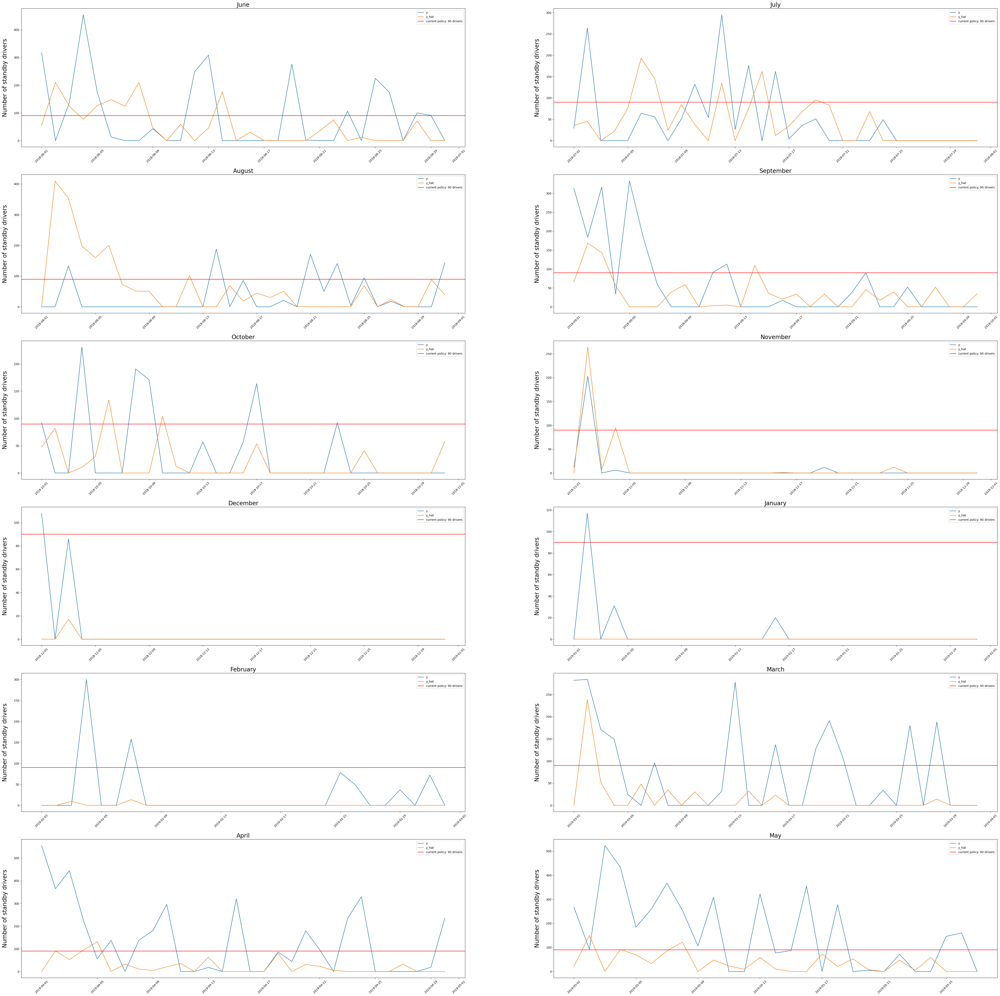

In [7]:
# baseline 

cv_sktime_models_one_year(model = NaiveForecaster(strategy = "mean", sp = 365), 
         statsforecast_df = data, 
         splits_dict = year_split, 
         custom_scorer = interpretable_scores,
                        transformer = None,
                          smoothing = None,
                         plotting = True) 


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 3.8665349163675486
Number of additional underpredictions = -3
Number of additional sby drivers required = 8.33207028008556

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 4.255114171774
Number of additional underpredictions = 0
Number of additional sby drivers required = -47.020925387828186

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 3.129560490217802
Number of additional underpredictions = -2
Number of additional sby drivers required = 23.587685165828034

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 0.7732418840951283
Number of additional underpredictions = -1
Number of additional sby drivers required = -13.822009782606187

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -0.1388526122632534
Number of additional underprediction

,regressors,y_pred_list,efficiency_losses,num_undershoots,magnitude_undershoots
0,"NaiveForecaster(sp=365, strategy='mean')","[144.0845963865811, 298.5845963865811, 212.584...",3.866535,-3,8.332070
1,"NaiveForecaster(sp=365, strategy='mean')","[111.52092538782819, 121.02092538782819, 76.02...",4.255114,0,-47.020925
2,"NaiveForecaster(sp=365, strategy='mean')","[72.41231483417197, 482.412314834172, 425.9123...",3.129560,-2,23.587685
3,"NaiveForecaster(sp=365, strategy='mean')","[139.48867644927287, 241.48867644927287, 216.9...",0.773242,-1,-13.822010
4,"NaiveForecaster(sp=365, strategy='mean')","[121.05992932172607, 155.5599293217261, 73.559...",-0.138853,-1,16.606737
5,"NaiveForecaster(sp=365, strategy='mean')","[77.12482378572939, 341.1248237857294, 84.1248...",1.306998,-1,-113.000000
6,"NaiveForecaster(sp=365, strategy='mean')","[78.79639940344549, 78.79639940344549, 95.7963...",0.186511,0,11.203601
7,"NaiveForecaster(sp=365, strategy='mean')","[77.72530982314085, 77.72530982314085, 77.7253...",-0.288678,0,12.274690
8,"NaiveForecaster(sp=365, strategy='mean')","[76.63472871460719, 76.63472871460719, 86.1347...",-1.569665,1,-41.468062
9,"NaiveForecaster(sp=365, strategy='mean')","[76.27263102018046, 314.7726310201805, 128.272...",-0.271664,-1,-3.568086


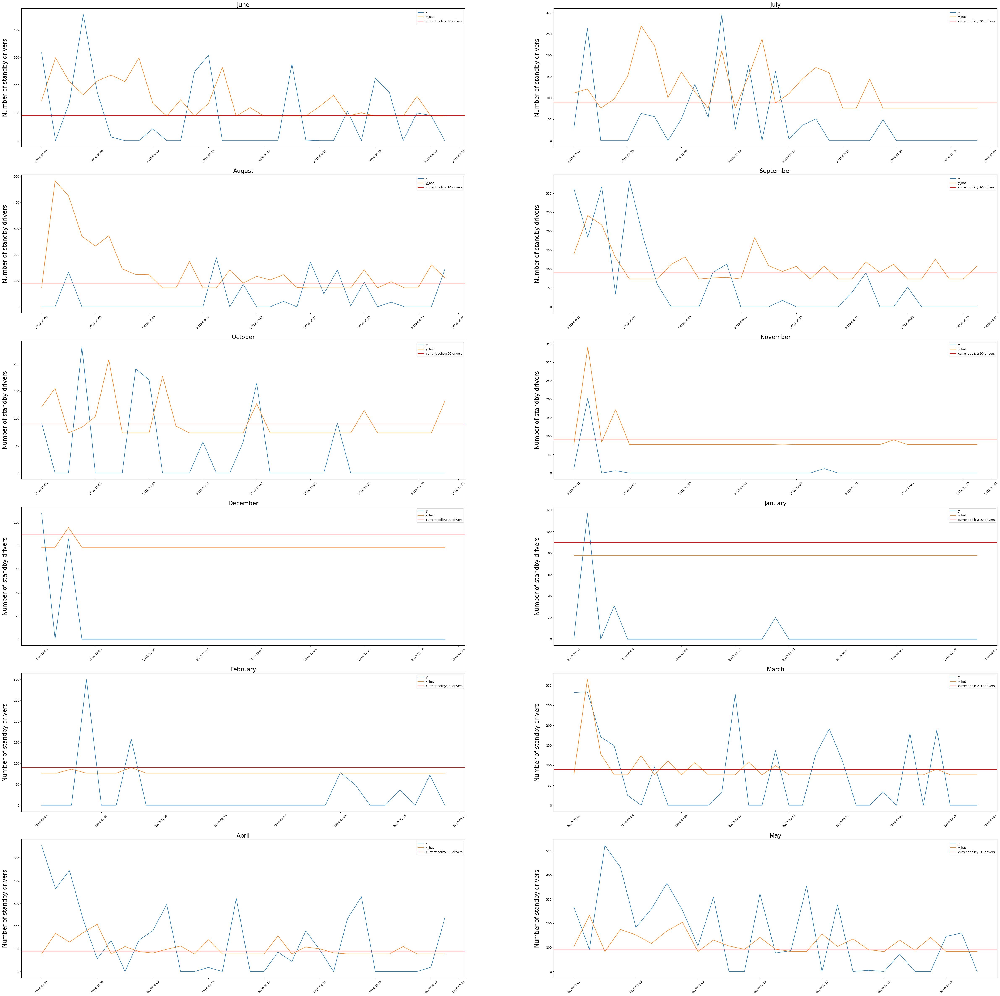

In [8]:

cv_sktime_models_one_year(model = NaiveForecaster(strategy = "mean", sp = 365), 
         statsforecast_df = data, 
         splits_dict = year_split, 
         custom_scorer = interpretable_scores,
                        transformer = None,
                          smoothing = None,
                         plotting = True,
                         interval = 0.7) 

As expected, using the upper bound of the 70 % prediction interval offsets the prediction in y direction.


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -0.4870571100024961
Number of additional underpredictions = 0
Number of additional sby drivers required = 38.66666666666666

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -25.59195377345524
Number of additional underpredictions = 2
Number of additional sby drivers required = -0.6571428571428584

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = -3.963594087173263
Number of additional underpredictions = 1
Number of additional sby drivers required = 47.67857142857143

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -4.9680502483669
Number of additional underpredictions = 4
Number of additional sby drivers required = -8.318181818181813

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -24.946236559139788
Number of additional underprediction

,regressors,y_pred_list,efficiency_losses,num_undershoots,magnitude_undershoots
0,"NaiveForecaster(sp=365, strategy='mean')","[78.0, 109.0, 116.625, 134.375, 118.875, 118.8...",-0.487057,0,38.666667
1,"NaiveForecaster(sp=365, strategy='mean')","[20.125, 20.125, 25.5, 35.375, 72.375, 108.875...",-25.591954,2,-0.657143
2,"NaiveForecaster(sp=365, strategy='mean')","[102.5, 190.875, 240.375, 280.375, 227.875, 15...",-3.963594,1,47.678571
3,"NaiveForecaster(sp=365, strategy='mean')","[90.25, 104.125, 108.375, 91.875, 49.875, 14.0...",-4.968050,4,-8.318182
4,"NaiveForecaster(sp=365, strategy='mean')","[41.0, 41.0, 35.0, 30.625, 43.625, 43.625, 41....",-24.946237,2,44.916667
5,"NaiveForecaster(sp=365, strategy='mean')","[80.5, 82.25, 91.375, 91.375, 25.375, 23.625, ...",-52.937995,1,-46.625000
6,"NaiveForecaster(sp=365, strategy='mean')","[0.0, 4.25, 4.25, 4.25, 4.25, 0.0, 0.0, 0.0, 0...",-84.014337,1,76.875000
7,"NaiveForecaster(sp=365, strategy='mean')","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",-94.946237,2,29.000000
8,"NaiveForecaster(sp=365, strategy='mean')","[0.0, 2.375, 2.375, 2.375, 2.375, 3.375, 3.375...",-62.063492,4,-24.291667
9,"NaiveForecaster(sp=365, strategy='mean')","[59.625, 72.625, 72.625, 72.625, 25.0, 12.0, 2...",-19.318996,2,44.964286


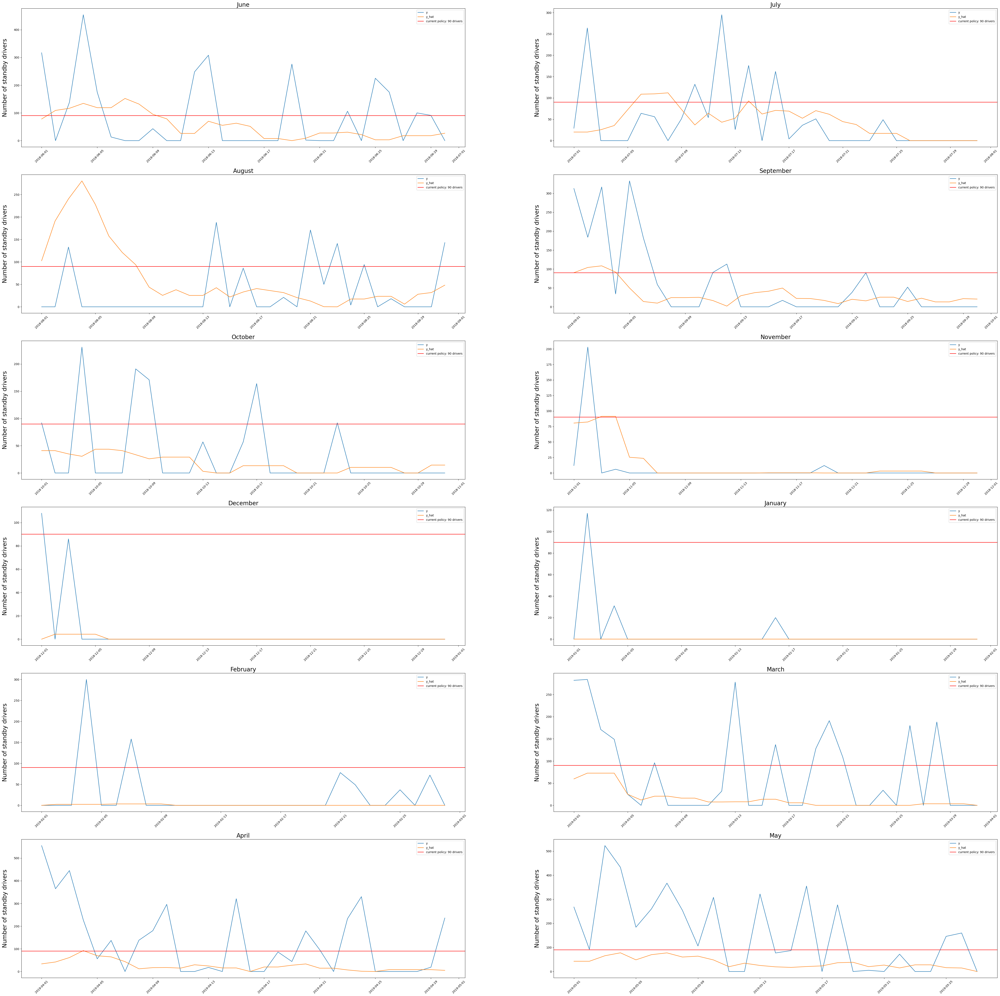

In [9]:

cv_sktime_models_one_year(model = NaiveForecaster(strategy = "mean", sp = 365), 
         statsforecast_df = data, 
         splits_dict = year_split, 
         custom_scorer = interpretable_scores,
                        transformer = None,
                          smoothing = "MA_oneday",
                         plotting = True) 

Likewise, as expected, using MA smoothing provides slack for on which days sby drivers would be required.


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 0.9647917800783219
Number of additional underpredictions = -1
Number of additional sby drivers required = 15.242820944191834

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 1.4533596185845035
Number of additional underpredictions = 0
Number of additional sby drivers required = -4.178381152755989

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 0.036942032087925014
Number of additional underpredictions = 0
Number of additional sby drivers required = 5.163152960115099

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -2.8111853235176554
Number of additional underpredictions = 2
Number of additional sby drivers required = -27.03067069403147

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -2.3655913978494603
Number of additional underpredi

,regressors,y_pred_list,efficiency_losses,num_undershoots,magnitude_undershoots
0,"NaiveForecaster(sp=365, strategy='mean')","[114.60945178308089, 145.60945178308089, 153.2...",0.964792,-1,15.242821
1,"NaiveForecaster(sp=365, strategy='mean')","[61.528381152756, 61.528381152756, 66.90338115...",1.453360,0,-4.178381
2,"NaiveForecaster(sp=365, strategy='mean')","[153.8368470398849, 242.2118470398849, 291.711...",0.036942,0,5.163153
3,"NaiveForecaster(sp=365, strategy='mean')","[129.55844847180924, 143.43344847180924, 147.6...",-2.811185,2,-27.030671
4,"NaiveForecaster(sp=365, strategy='mean')","[81.05008314087402, 81.05008314087402, 75.0500...",-2.365591,2,4.866584
5,"NaiveForecaster(sp=365, strategy='mean')","[122.04072992684354, 123.79072992684354, 132.9...",-0.330030,0,-33.790730
6,"NaiveForecaster(sp=365, strategy='mean')","[45.89671657395253, 50.14671657395253, 50.1467...",-0.143369,1,30.978283
7,"NaiveForecaster(sp=365, strategy='mean')","[45.36291257499435, 45.36291257499435, 45.3629...",-1.798709,0,44.637087
8,"NaiveForecaster(sp=365, strategy='mean')","[44.703109078002235, 47.078109078002235, 47.07...",-4.305217,3,-53.453109
9,"NaiveForecaster(sp=365, strategy='mean')","[103.92874289404062, 116.92874289404062, 116.9...",-2.365414,0,18.748340


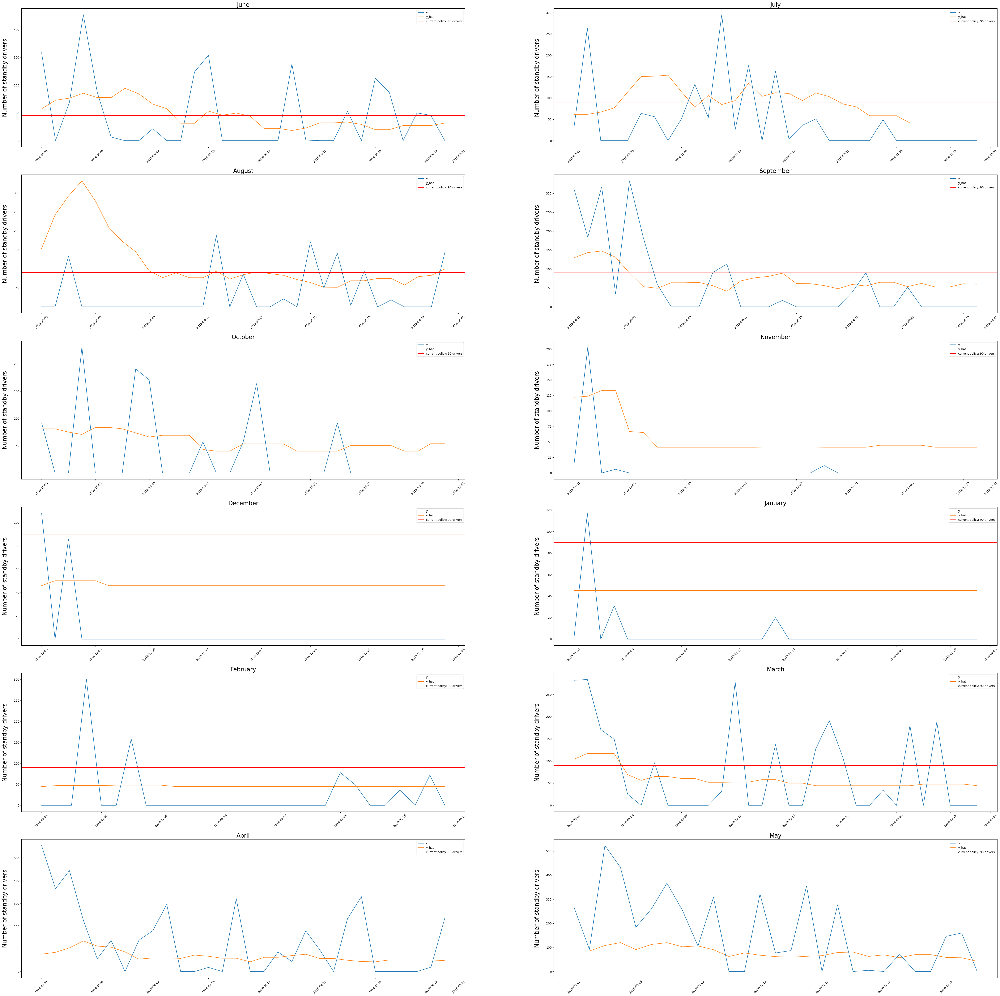

In [10]:

cv_sktime_models_one_year(model = NaiveForecaster(strategy = "mean", sp = 365), 
         statsforecast_df = data, 
         splits_dict = year_split, 
         custom_scorer = interpretable_scores,
                        transformer = None,
                          smoothing = "MA_oneday",
                         plotting = True,
                         interval = 0.6) 

Lastly, when combining the two approaches, slack could be produced in x and y. 

As intended, using those quickfixes reduced the number of additional days where sby driver needs were underpredicted.
However, this came at high costs in the efficiency metric, rendering the performance of those models as being insufficient.

In the following few figures, a few more different smoothing paradigms were tested, but they all lacked in performance.



Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -0.16503253234309057
Number of additional underpredictions = 0
Number of additional sby drivers required = 37.25

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -13.958094085552116
Number of additional underpredictions = 2
Number of additional sby drivers required = -6.773214285714289

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = -5.59134282664909
Number of additional underpredictions = 1
Number of additional sby drivers required = 41.69642857142857

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -6.42426271962136
Number of additional underpredictions = 4
Number of additional sby drivers required = -11.545454545454547

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -2.3655913978494603
Number of additional underpredictions = 2
Numb

,regressors,y_pred_list,efficiency_losses,num_undershoots,magnitude_undershoots
0,"NaiveForecaster(sp=365, strategy='mean')","[64.125, 79.9375, 98.4375, 113.9375, 134.375, ...",-0.165033,0,37.250000
1,"NaiveForecaster(sp=365, strategy='mean')","[21.6875, 31.0625, 46.25, 64.5, 67.5625, 73.68...",-13.958094,2,-6.773214
2,"NaiveForecaster(sp=365, strategy='mean')","[120.1875, 140.1875, 165.1875, 174.3125, 180.7...",-5.591343,1,41.696429
3,"NaiveForecaster(sp=365, strategy='mean')","[70.0625, 70.0625, 70.0625, 59.0625, 59.0625, ...",-6.424263,4,-11.545455
4,"NaiveForecaster(sp=365, strategy='mean')","[28.3125, 25.5625, 42.3125, 42.3125, 38.0, 32....",-2.365591,2,43.151042
5,"NaiveForecaster(sp=365, strategy='mean')","[52.9375, 52.9375, 52.9375, 52.9375, 45.6875, ...",-20.022301,1,-32.031250
6,"NaiveForecaster(sp=365, strategy='mean')","[2.125, 2.125, 2.125, 2.125, 2.125, 2.125, 2.1...",-77.562724,1,76.875000
7,"NaiveForecaster(sp=365, strategy='mean')","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",-91.720430,2,29.000000
8,"NaiveForecaster(sp=365, strategy='mean')","[1.1875, 1.1875, 1.1875, 2.875, 2.875, 2.875, ...",-47.777778,4,-29.260417
9,"NaiveForecaster(sp=365, strategy='mean')","[36.3125, 36.3125, 42.3125, 42.3125, 46.625, 4...",-11.371232,2,53.120536


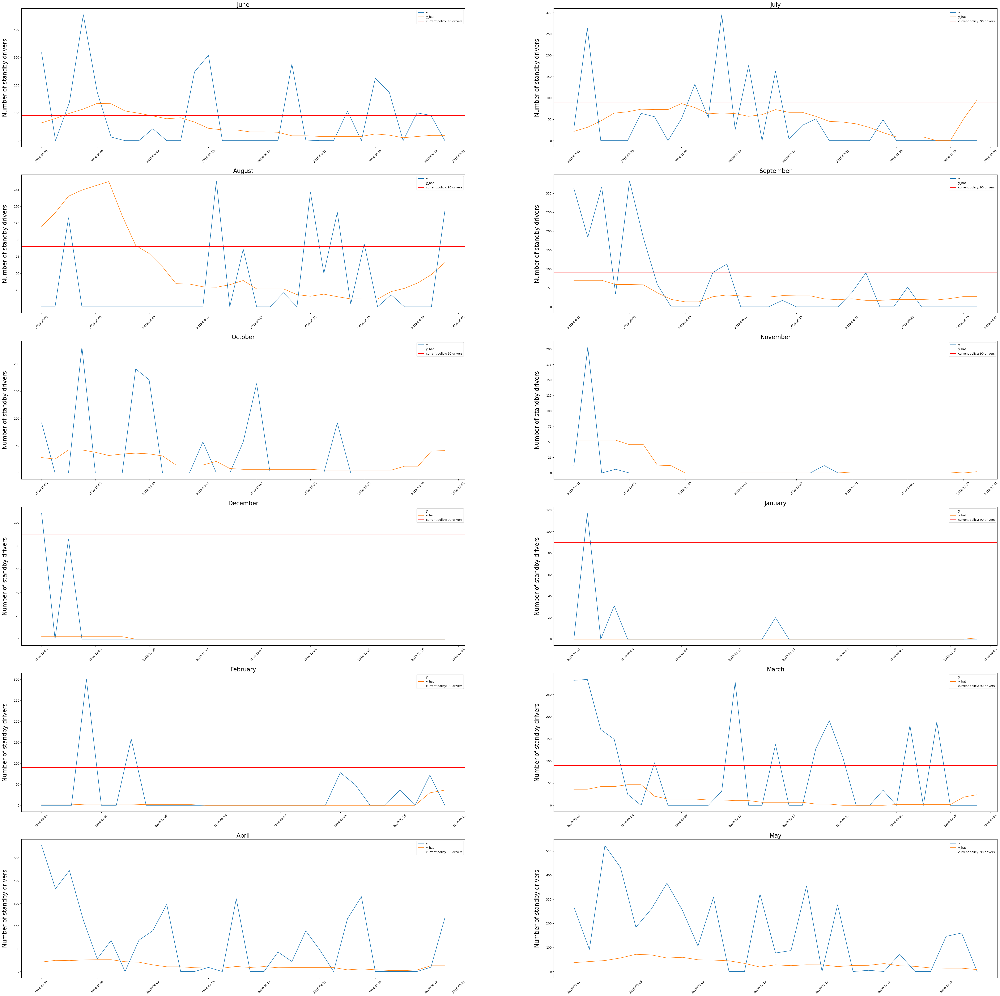

In [11]:

cv_sktime_models_one_year(model = NaiveForecaster(strategy = "mean", sp = 365), 
         statsforecast_df = data, 
         splits_dict = year_split, 
         custom_scorer = interpretable_scores,
                        transformer = None,
                          smoothing = "MA_weekly",
                         plotting = True)  


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -1.5745584515823552
Number of additional underpredictions = 0
Number of additional sby drivers required = 44.05989583333334

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -9.135107499734406
Number of additional underpredictions = 4
Number of additional sby drivers required = -21.971874999999997

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = -3.2280395580246264
Number of additional underpredictions = 2
Number of additional sby drivers required = 22.927734375

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -7.659514198711129
Number of additional underpredictions = 5
Number of additional sby drivers required = -9.520833333333329

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -2.3655913978494603
Number of additional underpredictions 

,regressors,y_pred_list,efficiency_losses,num_undershoots,magnitude_undershoots
0,"NaiveForecaster(sp=365, strategy='mean')","[53.53125, 53.53125, 51.0, 50.015625, 50.01562...",-1.574558,0,44.059896
1,"NaiveForecaster(sp=365, strategy='mean')","[39.71875, 40.78125, 41.96875, 44.953125, 47.5...",-9.135107,4,-21.971875
2,"NaiveForecaster(sp=365, strategy='mean')","[63.953125, 64.96875, 64.859375, 64.296875, 61...",-3.228040,2,22.927734
3,"NaiveForecaster(sp=365, strategy='mean')","[33.421875, 33.875, 32.484375, 32.59375, 31.01...",-7.659514,5,-9.520833
4,"NaiveForecaster(sp=365, strategy='mean')","[22.875, 23.4375, 22.8125, 21.765625, 21.76562...",-2.365591,2,45.024089
5,"NaiveForecaster(sp=365, strategy='mean')","[16.21875, 16.21875, 14.546875, 14.546875, 14....",-6.063369,1,-15.671875
6,"NaiveForecaster(sp=365, strategy='mean')","[0.953125, 0.953125, 0.921875, 0.921875, 0.921...",-38.853047,1,78.062500
7,"NaiveForecaster(sp=365, strategy='mean')","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",-53.010753,2,29.000000
8,"NaiveForecaster(sp=365, strategy='mean')","[0.71875, 0.71875, 0.71875, 0.71875, 0.71875, ...",-4.920635,4,-31.968750
9,"NaiveForecaster(sp=365, strategy='mean')","[14.328125, 14.328125, 14.328125, 14.328125, 1...",-6.415771,3,42.977083


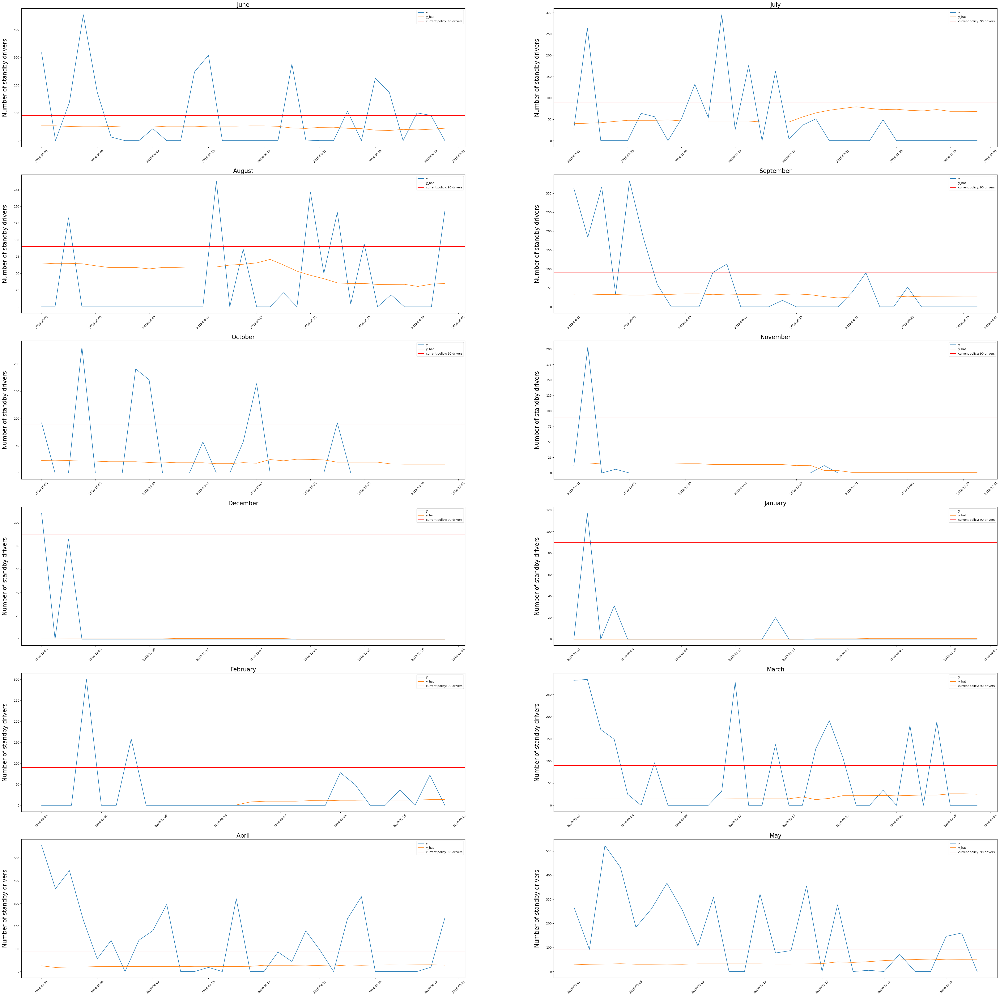

In [12]:
cv_sktime_models_one_year(model = NaiveForecaster(strategy = "mean", sp = 365), 
         statsforecast_df = data, 
         splits_dict = year_split, 
         custom_scorer = interpretable_scores,
                        transformer = None,
                          smoothing = "MA_monthly",
                         plotting = True)  


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -0.4150213165590486
Number of additional underpredictions = 0
Number of additional sby drivers required = 20.587220543824998

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -0.5394177143384447
Number of additional underpredictions = 0
Number of additional sby drivers required = 9.827051834026022

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = -0.7460235891390461
Number of additional underpredictions = 0
Number of additional sby drivers required = 15.036010051763142

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -1.4515939709391574
Number of additional underpredictions = 1
Number of additional sby drivers required = -3.0699961132385027

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -2.3655913978494603
Number of additional underpred

,regressors,y_pred_list,efficiency_losses,num_undershoots,magnitude_undershoots
0,"NaiveForecaster(sp=365, strategy='mean')","[77.00392528950833, 77.00392528950833, 74.4726...",-0.415021,0,20.587221
1,"NaiveForecaster(sp=365, strategy='mean')","[75.41982316597397, 76.48232316597397, 77.6698...",-0.539418,0,9.827052
2,"NaiveForecaster(sp=365, strategy='mean')","[92.7426357815702, 93.7582607815702, 93.648885...",-0.746024,0,15.036010
3,"NaiveForecaster(sp=365, strategy='mean')","[78.69890236323849, 79.15202736323849, 77.7614...",-1.451594,1,-3.069996
4,"NaiveForecaster(sp=365, strategy='mean')","[48.11644947389894, 48.67894947389894, 48.0539...",-2.365591,2,19.782639
5,"NaiveForecaster(sp=365, strategy='mean')","[43.24172240261555, 43.24172240261555, 41.5698...",-1.579232,0,46.758278
6,"NaiveForecaster(sp=365, strategy='mean')","[30.968634764883614, 30.968634764883614, 30.93...",-0.143369,1,48.046990
7,"NaiveForecaster(sp=365, strategy='mean')","[37.78140911375481, 37.78140911375481, 37.7814...",-2.526463,0,52.218591
8,"NaiveForecaster(sp=365, strategy='mean')","[38.35230364694277, 38.35230364694277, 38.3523...",-3.928156,2,-31.414804
9,"NaiveForecaster(sp=365, strategy='mean')","[44.33858908836601, 44.33858908836601, 44.3385...",-2.980236,0,43.565057


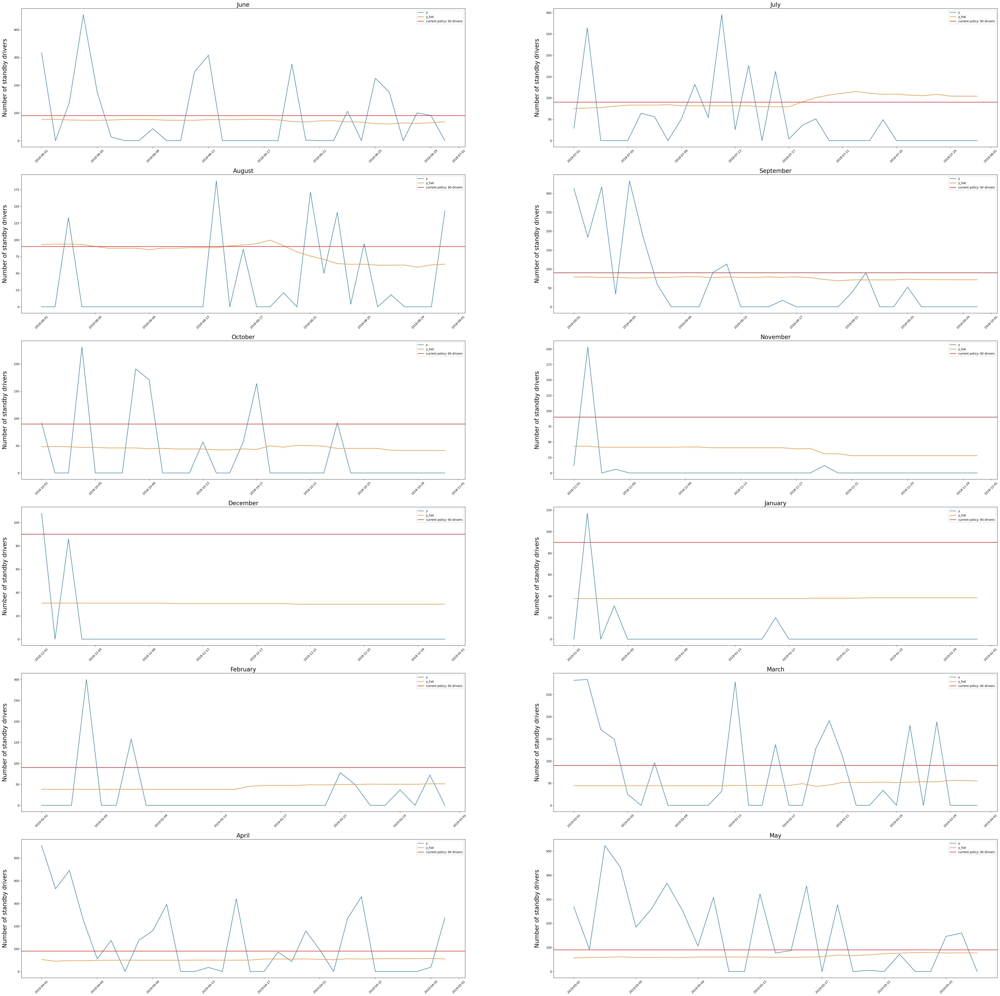

In [13]:
cv_sktime_models_one_year(model = NaiveForecaster(strategy = "mean", sp = 365), 
         statsforecast_df = data, 
         splits_dict = year_split, 
         custom_scorer = interpretable_scores,
                        transformer = None,
                          smoothing = "MA_monthly",
                         plotting = True,
                         interval = 0.7) 


Most of the time, the resulting predictions from the "fixed" naive forecasters were simply "too flat"; not sufficiently taking the seasonality of the data into account when predicting driver needs.

### TBATS modeling

In an effort to finding models providing more dynamic predictions than the previously tested approaches as well as the intermittent demand forecasting strategies, several potentially fruitful models came to mind when reading Hyndman's & Athanasopoulos' "Forecasting: Principles & Practice" https://otexts.com/fpp2/.

The most promising candidate model appeared to be the TBATS model http://dx.doi.org/10.1198/jasa.2011.tm09771 (Trigonometric, Box-Cox transform, ARMA errors, Trend and Seasonal components) which can be used to model complex seasonal patterns using exponential smoothing.

In TBATS, potential seasonal period lengths can be specified after which the algorithm tests a variety of approaches such as using a Box-Cox transform, modelling the prediction error with an ARMA process, and using a different number of harmonics to model time varying coefficients for the seasonal patterns http://dx.doi.org/10.1198/jasa.2011.tm09771. 
The composition of the final model is determined by the combination of tested approaches that produces the lowest value in the Akaike information criterion (AIC).



In this notebook, several parameter combinations were tested and plotted to get a feeling for how these would influence the models' performances.


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -3.6135705538300726
Number of additional underpredictions = 0
Number of additional sby drivers required = 31.790364583333343

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -4.358343418870472
Number of additional underpredictions = 2
Number of additional sby drivers required = -13.784543895886415

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = -5.030809105723524
Number of additional underpredictions = 2
Number of additional sby drivers required = 2.581741597312302

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -33.77586257528889
Number of additional underpredictions = 5
Number of additional sby drivers required = -15.223588880520609

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -12.043010752688172
Number of additional underpredic

,regressors,y_pred_list,efficiency_losses,num_undershoots,magnitude_undershoots
0,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[87.75390625, 106.541748046875, 119.6015625, 1...",-3.613571,0,31.790365
1,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[63.365379559063676, 80.64823248831061, 138.73...",-4.358343,2,-13.784544
2,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[94.7483860719815, 111.14810644706978, 116.173...",-5.030809,2,2.581742
3,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[52.98738737564129, 62.7788353262914, 60.96047...",-33.775863,5,-15.223589
4,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[37.14141770239893, 104.16366188262809, 108.99...",-12.043011,2,22.567350
5,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[53.14460496777034, 63.71257049112468, 65.0390...",-36.654236,1,-37.356285
6,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[20.819129070051062, 30.803517641790055, 30.07...",-61.433692,1,53.554793
7,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[45.13631717321243, 51.58271858421103, 56.4787...",-61.512177,1,15.708641
8,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[34.2685546875, 38.703125, 29.5234375, 4.11718...",-26.349206,4,-30.225260
9,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[9.647033460935614, 25.55718104843544, 42.5660...",-13.419187,1,50.514363


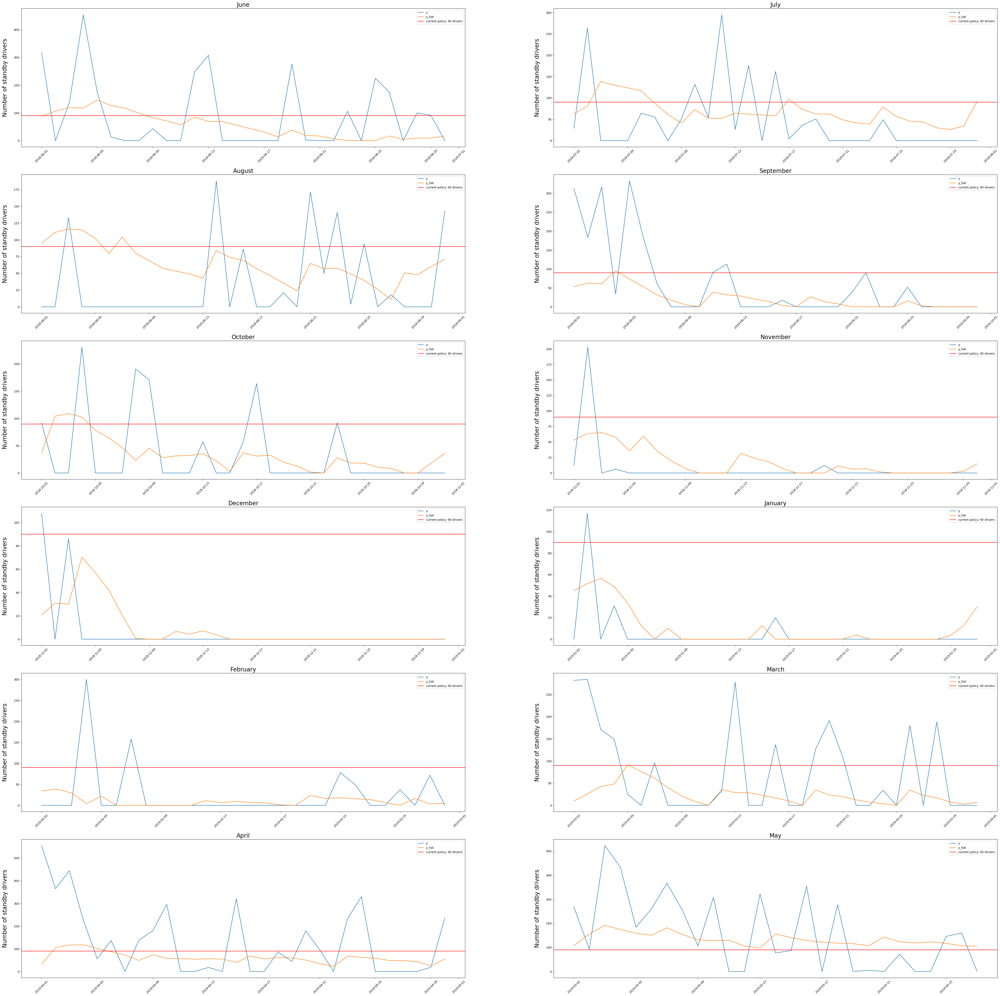

In [14]:
# these are the default settings 
# with yearly, monthly and weekly seasonalities.
# the weirdly looking decimals result from averaging over 
# leap years and different month lengths 

forecaster = TBATS(sp = [365.25, 30.4375, 7], 
                  use_box_cox = None,
                  use_trend = None,
                  use_damped_trend = None,
                  use_arma_errors = None,
                  n_jobs = -1)
                    
cv_sktime_models_one_year(model = forecaster, 
         statsforecast_df = data, 
         splits_dict = year_split, 
         custom_scorer = interpretable_scores,
                        transformer = None,
                          smoothing = None,
                         plotting = True) 

As apparent in the figure, TBATS is able to create a more seasonal pattern in the predictions where predictions are highest at the beginning of each month and decrease over the course of it, while there are recurring peaks at the beginning of each week.

However, interestingly, the default TBATS does not really beat the default naive forecaster in terms of performance in the business metrics. 

Additionally, again, predictions appeared to be too low to cover the sby needs. 

Thus, it was tested whether using the upper bound of the prediction interval or smoothing the data would improve the model.

I will summarize the the models' performances at the end of the notebook.

(In the next cell I shortly show that shutting off the box-cox, trend, damped_trend and arma_error usage in the TBATS algorithm does not reduce its performance. 
However, shutting off those parameters sped up the training process, which is why I went for those settings for most of my model engineering in the following.)


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -1.7952836826606102
Number of additional underpredictions = 1
Number of additional sby drivers required = 18.75389107244544

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -4.358343418870472
Number of additional underpredictions = 2
Number of additional sby drivers required = -13.784543895886415

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = -4.103718432276391
Number of additional underpredictions = 1
Number of additional sby drivers required = 11.396363052594594

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -27.010850552961337
Number of additional underpredictions = 5
Number of additional sby drivers required = -21.139528448819462

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -15.268817204301076
Number of additional underpredi

,regressors,y_pred_list,efficiency_losses,num_undershoots,magnitude_undershoots
0,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[66.74673578056003, 98.25267705161119, 98.3206...",-1.795284,1,18.753891
1,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[63.365379559063676, 80.64823248831061, 138.73...",-4.358343,2,-13.784544
2,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[98.13986614438456, 132.68561958646876, 131.61...",-4.103718,1,11.396363
3,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[53.96844139029645, 73.83650101527023, 67.4269...",-27.010851,5,-21.139528
4,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[41.442829490730446, 114.4188586424358, 105.70...",-15.268817,2,27.794147
5,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[61.810665035410544, 71.69569824686175, 68.143...",-43.225093,1,-41.347849
6,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[21.50545139317367, 38.61800426709515, 36.9419...",-61.433692,1,49.776297
7,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[58.650285752476385, 60.02244019615029, 49.889...",-52.131941,1,9.064514
8,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[54.88128790353113, 46.94891257288575, 35.4911...",-33.492063,4,-32.820110
9,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[0.8021708586903387, 21.16699828022872, 39.927...",-19.963178,1,50.278281


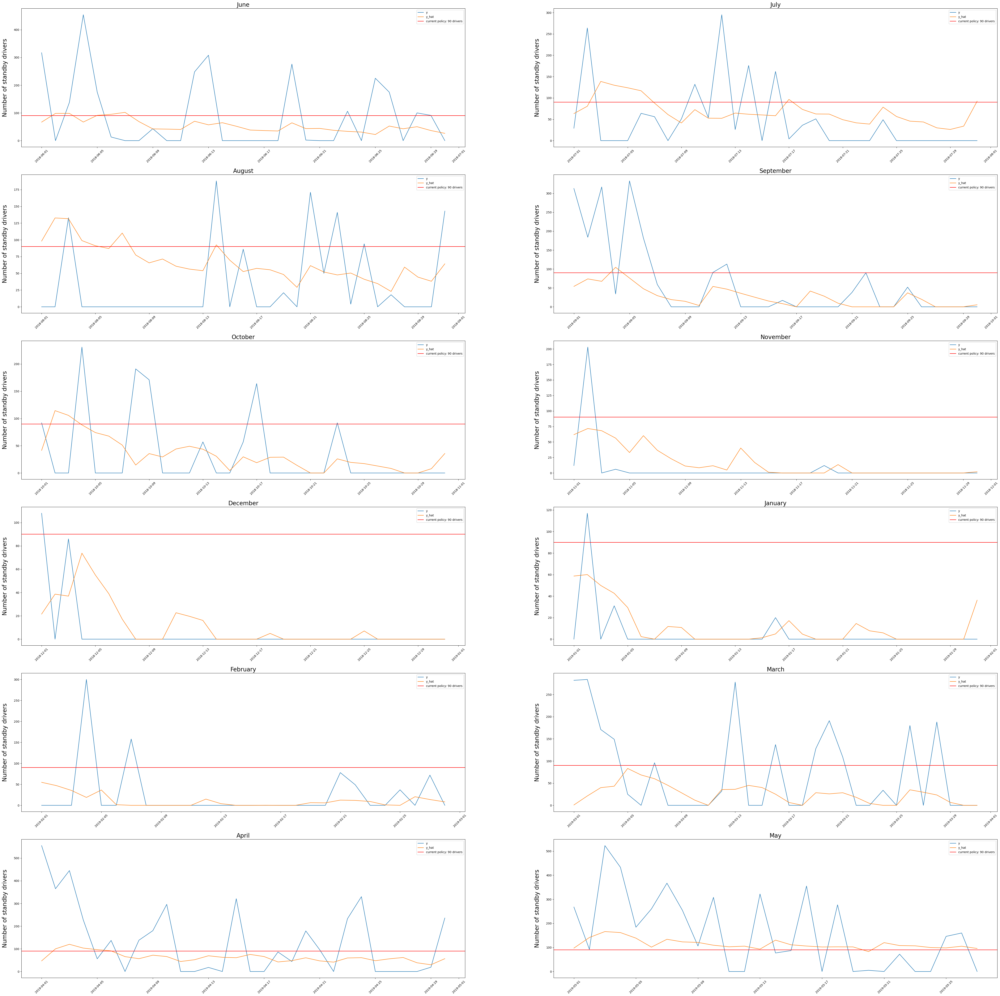

In [15]:


forecaster = TBATS(sp = [365.25, 30.4375, 7],
                  use_box_cox = False,
                  use_trend = False,
                  use_damped_trend = False,
                  use_arma_errors = False,
                  n_jobs = -1)
                    
cv_sktime_models_one_year(model = forecaster, 
         statsforecast_df = data, 
         splits_dict = year_split, 
         custom_scorer = interpretable_scores,
                        transformer = None,
                          smoothing = None,
                         plotting = True) 


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 0.37524498030518316
Number of additional underpredictions = -1
Number of additional sby drivers required = -6.425544344187983

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 3.758650451061815
Number of additional underpredictions = 0
Number of additional sby drivers required = -25.46260768277729

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 1.4868817227857605
Number of additional underpredictions = -1
Number of additional sby drivers required = -20.51187149131738

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -0.9230750152831035
Number of additional underpredictions = 0
Number of additional sby drivers required = -12.135873753019737

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 0.002708760520320652
Number of additional underpre

,regressors,y_pred_list,efficiency_losses,num_undershoots,magnitude_undershoots
0,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[114.68245456505383, 146.20586644516874, 146.2...",0.375245,-1,-6.425544
1,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[113.58252886692823, 130.8694141235297, 188.97...",3.758650,0,-25.462608
2,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[149.4824698913096, 184.03428821041152, 182.97...",1.486882,-1,-20.511871
3,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[105.35866584877138, 125.24747157942372, 118.8...",-0.923075,0,-12.135874
4,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[93.89384950992664, 166.88326918597443, 158.17...",0.002709,-1,13.789368
5,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[114.36581588157969, 124.26418489042169, 120.7...",-0.621474,0,-34.264185
6,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[73.68713775277932, 90.80525871111888, 89.1409...",-0.029705,0,16.312862
7,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[108.87409114417665, 110.24885721200238, 100.1...",-0.418157,0,-20.248857
8,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[104.48096220130299, 96.55158808366605, 85.100...",-4.193586,3,-64.331506
9,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[51.55970937737687, 71.93097691517795, 90.6960...",-0.513356,-1,19.086536


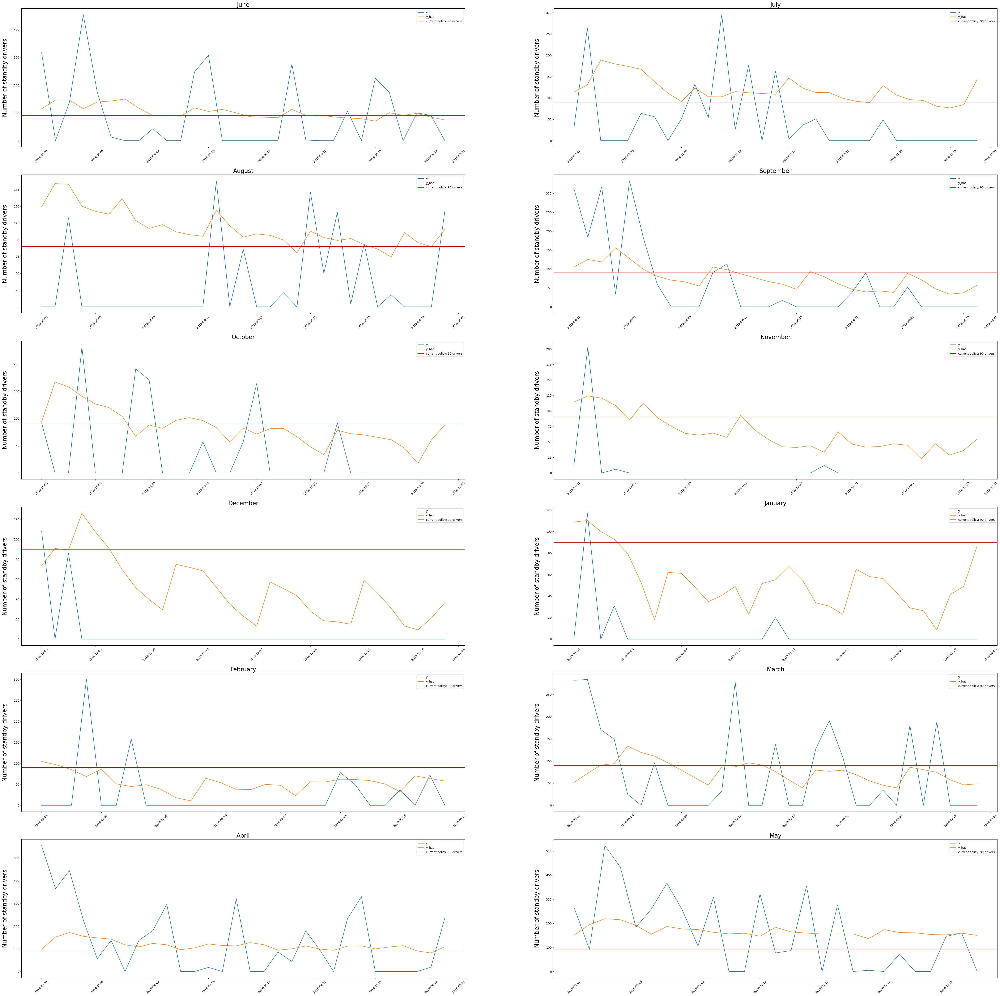

In [16]:
forecaster = TBATS(sp = [365.25, 30.4375, 7],
                  use_box_cox = False,
                  use_trend = False,
                  use_damped_trend = False,
                  use_arma_errors = False,
                  n_jobs = -1)
                    
cv_sktime_models_one_year(model = forecaster, 
         statsforecast_df = data, 
         splits_dict = year_split, 
         custom_scorer = interpretable_scores,
                        transformer = None,
                          smoothing = None,
                         plotting = True,
                         interval = 0.6) 


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 1.2648216139522575
Number of additional underpredictions = -3
Number of additional sby drivers required = 8.53371462816429

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 4.845985445068376
Number of additional underpredictions = -1
Number of additional sby drivers required = -16.781815396456096

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 2.5853401996915863
Number of additional underpredictions = -2
Number of additional sby drivers required = -24.141013005066803

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 0.6788060723145364
Number of additional underpredictions = 0
Number of additional sby drivers required = -24.0439137703207

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 0.867464343709166
Number of additional underpredictio

,regressors,y_pred_list,efficiency_losses,num_undershoots,magnitude_undershoots
0,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[125.7782543732166, 157.30571021857523, 157.39...",1.264822,-3,8.533715
1,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[125.20641706106807, 142.49423569049094, 200.6...",4.845985,-1,-16.781815
2,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[161.36686981794614, 195.92009198918498, 194.8...",2.585340,-2,-24.141013
3,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[117.25408865970961, 137.1476965429372, 130.74...",0.678806,0,-24.043914
4,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[106.03481730230276, 179.02733651625667, 170.3...",0.867464,-1,1.630222
5,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[126.5308870949381, 136.43234297390288, 132.88...",-0.248505,0,-46.432343
6,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[85.7657622144577, 102.88517203111803, 101.223...",0.341778,0,4.234238
7,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[120.49952003856296, 121.87489062551344, 111.7...",0.034557,-1,-27.000000
8,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[115.96192192222364, 108.03324250281108, 96.58...",-3.019028,1,-30.307524
9,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[63.30868280344425, 83.68144105094164, 102.447...",0.442148,-1,7.319027


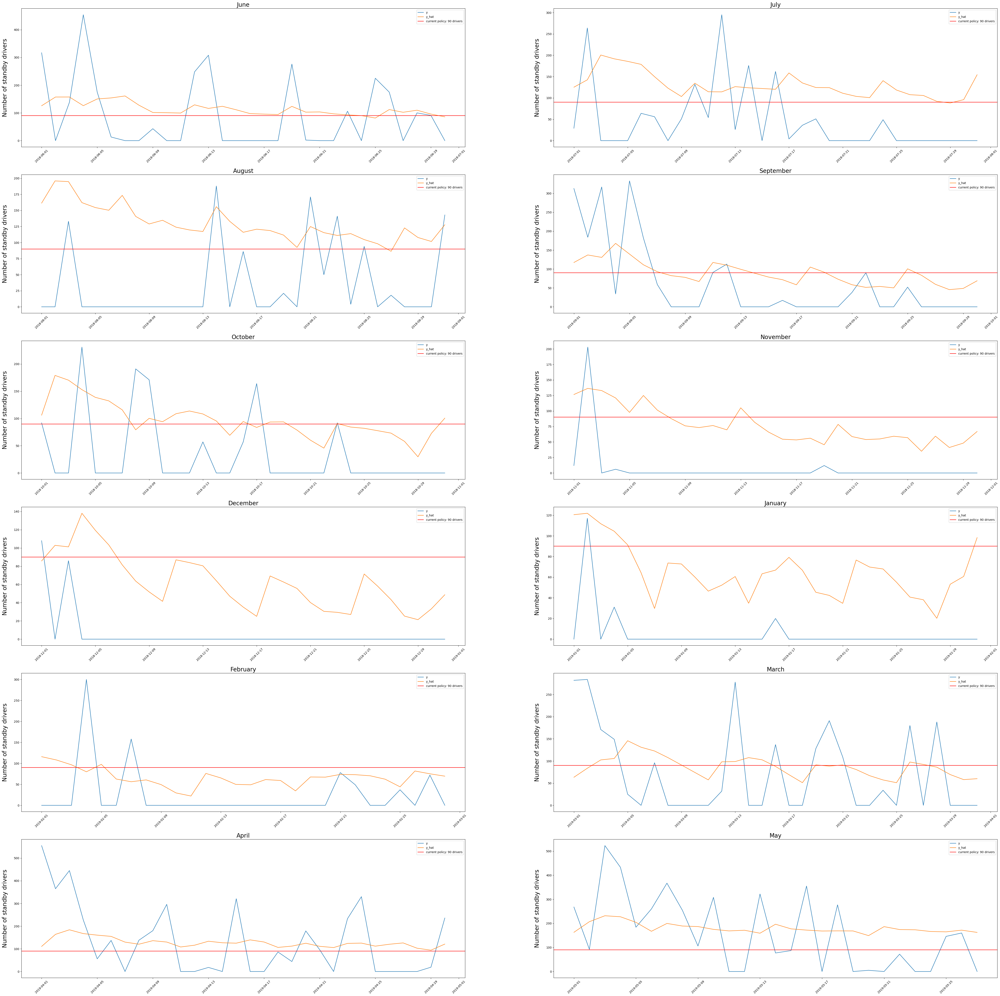

In [17]:
forecaster = TBATS(sp = [365.25, 30.4375, 7],
                  use_box_cox = False,
                  use_trend = False,
                  use_damped_trend = False,
                  use_arma_errors = False,
                  n_jobs = -1)
                    
cv_sktime_models_one_year(model = forecaster, 
         statsforecast_df = data, 
         splits_dict = year_split, 
         custom_scorer = interpretable_scores,
                        transformer = None,
                          smoothing = None,
                         plotting = True,
                         interval = 0.7) 


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -18.816279803918377
Number of additional underpredictions = 2
Number of additional sby drivers required = 50.00777030887372

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 3.2886828281262623
Number of additional underpredictions = 0
Number of additional sby drivers required = -19.41073912456804

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = -4.071614145747162
Number of additional underpredictions = 2
Number of additional sby drivers required = 10.171478147629244

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -5.215168057868176
Number of additional underpredictions = 3
Number of additional sby drivers required = -16.505516274159348

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -53.97849462365592
Number of additional underpredicti

,regressors,y_pred_list,efficiency_losses,num_undershoots,magnitude_undershoots
0,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[20.74581874015457, 31.868550510850923, 33.060...",-18.816280,2,50.007770
1,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[98.78557273428393, 121.52824371844122, 141.18...",3.288683,0,-19.410739
2,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[79.65182063477299, 99.04641106446893, 108.127...",-4.071614,2,10.171478
3,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[70.59708946368691, 81.04199286999656, 92.3189...",-5.215168,3,-16.505516
4,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[10.013530216804327, 34.0463602064182, 56.0655...",-53.978495,2,53.954178
5,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[50.94518474312308, 62.17360703646829, 66.9088...",-36.678966,1,-36.586804
6,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[9.940359331882554, 22.428406086136135, 41.399...",-71.111111,1,53.329879
7,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[36.49571274836215, 58.16417953783562, 71.8764...",-25.517608,1,7.869640
8,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[42.169997770651946, 51.65853263491286, 47.945...",-33.492063,4,-35.359304
9,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[4.142297383266584, 15.694041693436235, 27.552...",-4.522535,2,48.852264


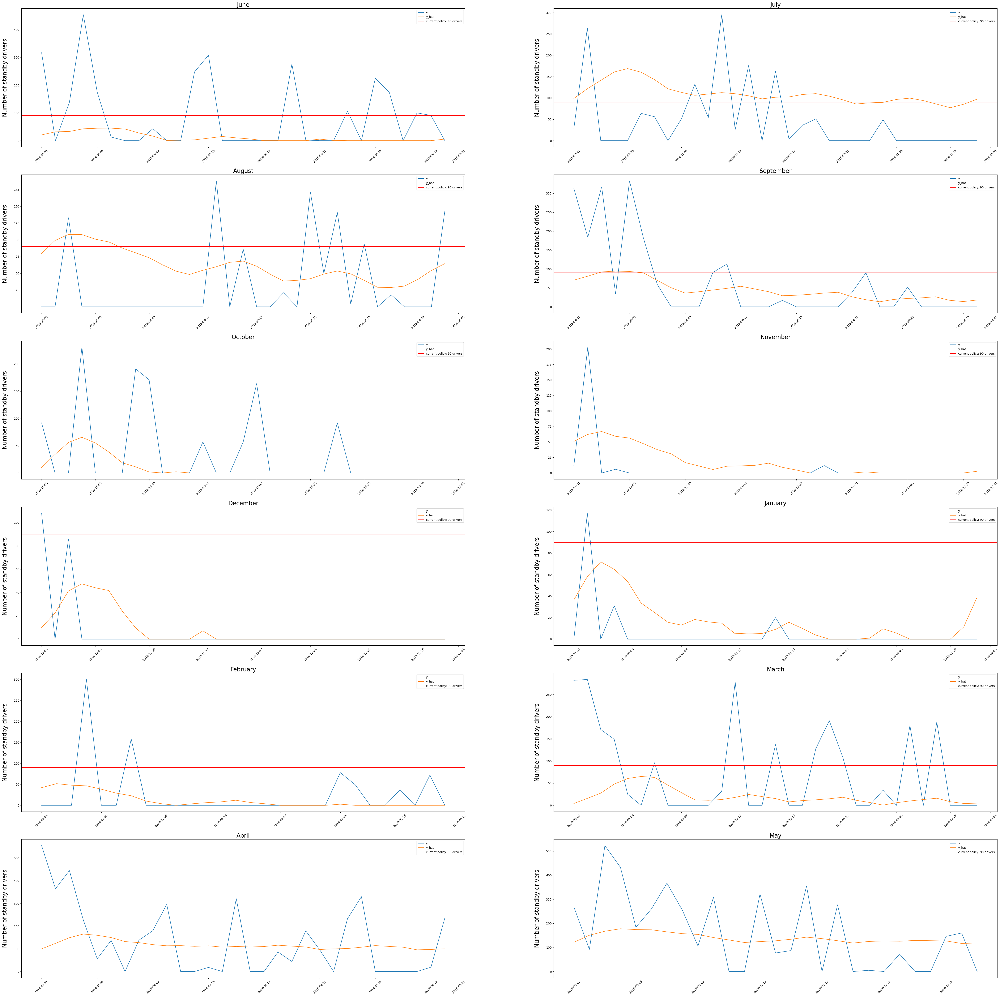

In [18]:
forecaster = TBATS(sp = [365.25, 30.4375, 7],
                  use_box_cox = False,
                  use_trend = False,
                  use_damped_trend = False,
                  use_arma_errors = False,
                  n_jobs = -1)
                    
cv_sktime_models_one_year(model = forecaster, 
         statsforecast_df = data, 
         splits_dict = year_split, 
         custom_scorer = interpretable_scores,
                        transformer = None,
                          smoothing = "MA_oneday",
                         plotting = True) 


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -2.499845783818806
Number of additional underpredictions = 1
Number of additional sby drivers required = 50.170325819933566

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 4.265572672900149
Number of additional underpredictions = 0
Number of additional sby drivers required = -33.7818592029263

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 0.4706448566328305
Number of additional underpredictions = -1
Number of additional sby drivers required = -3.900957174410422

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -6.717153072088436
Number of additional underpredictions = 4
Number of additional sby drivers required = -5.667548935559935

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -2.3655913978494603
Number of additional underpredictio

,regressors,y_pred_list,efficiency_losses,num_undershoots,magnitude_undershoots
0,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[30.292293306957426, 43.381038021948214, 49.52...",-2.499846,1,50.170326
1,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[126.25377909973244, 137.34569484985002, 145.7...",4.265573,0,-33.781859
2,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[122.48898070763653, 130.49887616925892, 136.4...",0.470645,-1,-3.900957
3,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[52.37862614454733, 59.511476312431554, 64.588...",-6.717153,4,-5.667549
4,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[53.42279203905369, 58.78463787770448, 67.3418...",-2.365591,2,24.626169
5,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[23.952230332015795, 29.575631539338765, 43.55...",-57.663547,1,-20.287816
6,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[16.707327798384583, 21.708103913161924, 29.42...",-61.433692,1,55.932745
7,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[18.916285077589357, 26.163568771582042, 30.80...",-62.688172,2,10.019816
8,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[25.458452371526256, 38.64278169183901, 43.819...",-12.063492,4,-34.747639
9,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[6.8227858643198545, 19.776914848969753, 27.22...",-5.101435,2,54.044667


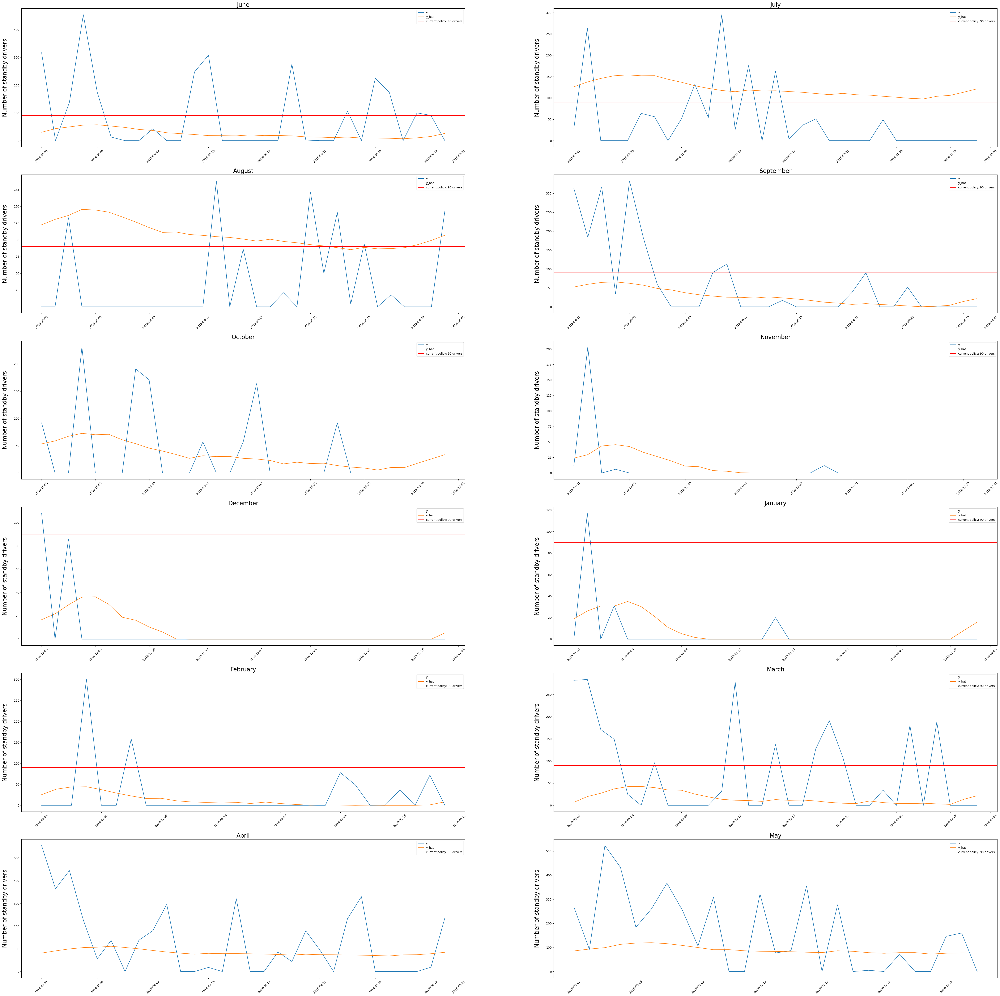

In [19]:
forecaster = TBATS(sp = [365.25, 30.4375, 7],
                  use_box_cox = False,
                  use_trend = False,
                  use_damped_trend = False,
                  use_arma_errors = False,
                  n_jobs = -1)
                    
cv_sktime_models_one_year(model = forecaster, 
         statsforecast_df = data, 
         splits_dict = year_split, 
         custom_scorer = interpretable_scores,
                        transformer = None,
                          smoothing = "MA_weekly",
                         plotting = True) 


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -18.816279803918377
Number of additional underpredictions = 2
Number of additional sby drivers required = 50.00777030887372

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 3.2886828281262623
Number of additional underpredictions = 0
Number of additional sby drivers required = -19.41073912456804

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = -4.071614145747162
Number of additional underpredictions = 2
Number of additional sby drivers required = 10.171478147629244

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -5.215168057868176
Number of additional underpredictions = 3
Number of additional sby drivers required = -16.505516274159348

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -53.97849462365592
Number of additional underpredicti

,regressors,y_pred_list,efficiency_losses,num_undershoots,magnitude_undershoots
0,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[20.74581874015457, 31.868550510850923, 33.060...",-18.816280,2,50.007770
1,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[98.78557273428393, 121.52824371844122, 141.18...",3.288683,0,-19.410739
2,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[79.65182063477299, 99.04641106446893, 108.127...",-4.071614,2,10.171478
3,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[70.59708946368691, 81.04199286999656, 92.3189...",-5.215168,3,-16.505516
4,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[10.013530216804327, 34.0463602064182, 56.0655...",-53.978495,2,53.954178
5,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[50.94518474312308, 62.17360703646829, 66.9088...",-36.678966,1,-36.586804
6,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[9.940359331882554, 22.428406086136135, 41.399...",-71.111111,1,53.329879
7,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[36.49571274836215, 58.16417953783562, 71.8764...",-25.517608,1,7.869640
8,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[42.169997770651946, 51.65853263491286, 47.945...",-33.492063,4,-35.359304
9,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[4.142297383266584, 15.694041693436235, 27.552...",-4.522535,2,48.852264


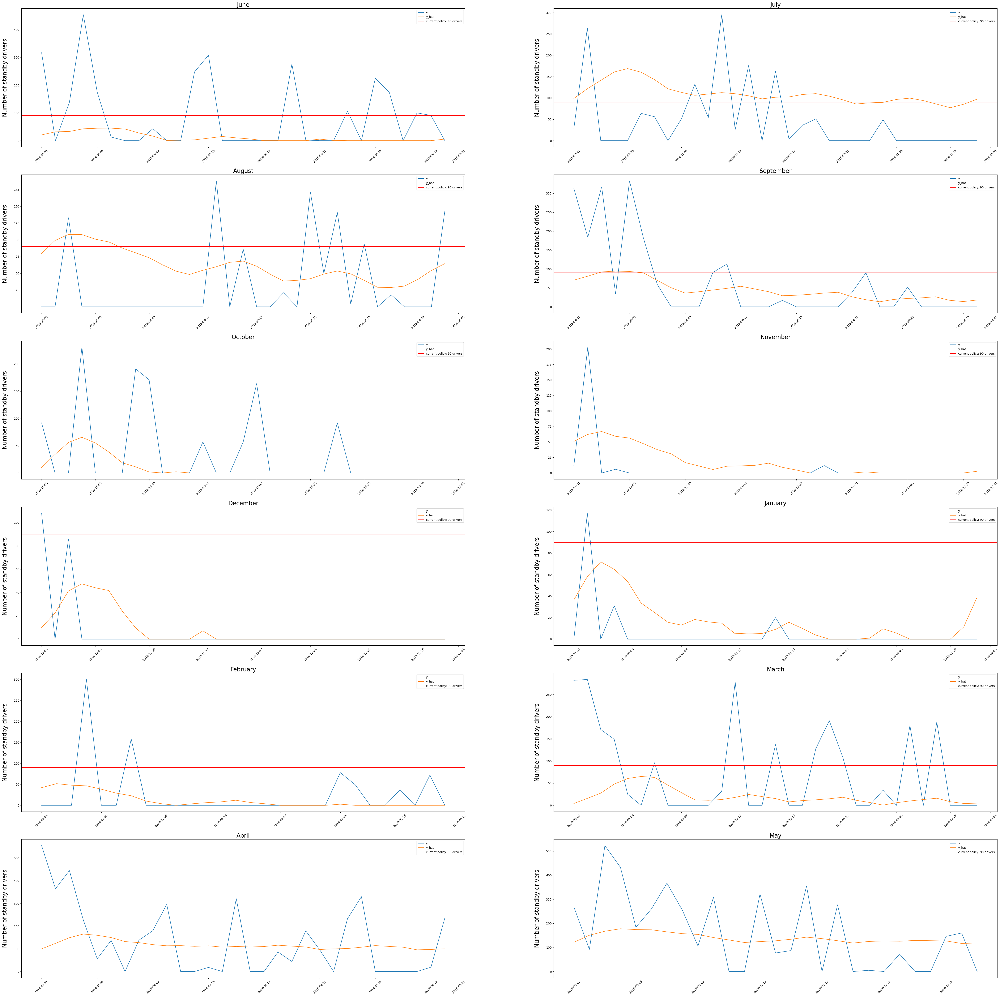

In [20]:
forecaster = TBATS(sp = [365.25, 30.4375, 7],
                  use_box_cox = False,
                  use_trend = False,
                  use_damped_trend = False,
                  use_arma_errors = False,
                  n_jobs = -1)
                    
cv_sktime_models_one_year(model = forecaster, 
         statsforecast_df = data, 
         splits_dict = year_split, 
         custom_scorer = interpretable_scores,
                        transformer = None,
                          smoothing = "MA_oneday",
                         plotting = True) 


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 3.9634017415017837
Number of additional underpredictions = -3
Number of additional sby drivers required = -2.554859804956422

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 12.440420402343637
Number of additional underpredictions = -3
Number of additional sby drivers required = -61.93996515969005

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 9.143955036770652
Number of additional underpredictions = -6
Number of additional sby drivers required = -55.0

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 8.361272326080584
Number of additional underpredictions = -3
Number of additional sby drivers required = -29.696616551871955

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 2.4652957104976743
Number of additional underpredictions = -2
Nu

,regressors,y_pred_list,efficiency_losses,num_undershoots,magnitude_undershoots
0,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[112.8460895678588, 126.91304523479164, 130.94...",3.963402,-3,-2.554860
1,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[191.0986669345912, 216.9187648795267, 239.549...",12.440420,-3,-61.939965
2,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[178.71020682896122, 201.2173588986177, 213.30...",9.143955,-6,-55.000000
3,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[168.46107719107692, 181.99356188952805, 196.2...",8.361272,-3,-29.696617
4,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[105.46323246197007, 132.66846228785846, 157.7...",2.465296,-2,-15.005734
5,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[149.96043665649415, 164.29934299050566, 172.0...",0.439894,0,-74.299343
6,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[104.05103830253037, 119.66643386796027, 141.7...",1.124725,0,-14.051038
7,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[133.1416932119767, 157.84775254635736, 174.48...",1.628542,-1,-27.000000
8,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[137.6335203614402, 150.11200385972478, 149.29...",3.613378,0,-52.889965
9,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[89.60581710569474, 104.42049952349801, 119.42...",3.980753,-4,-10.568337


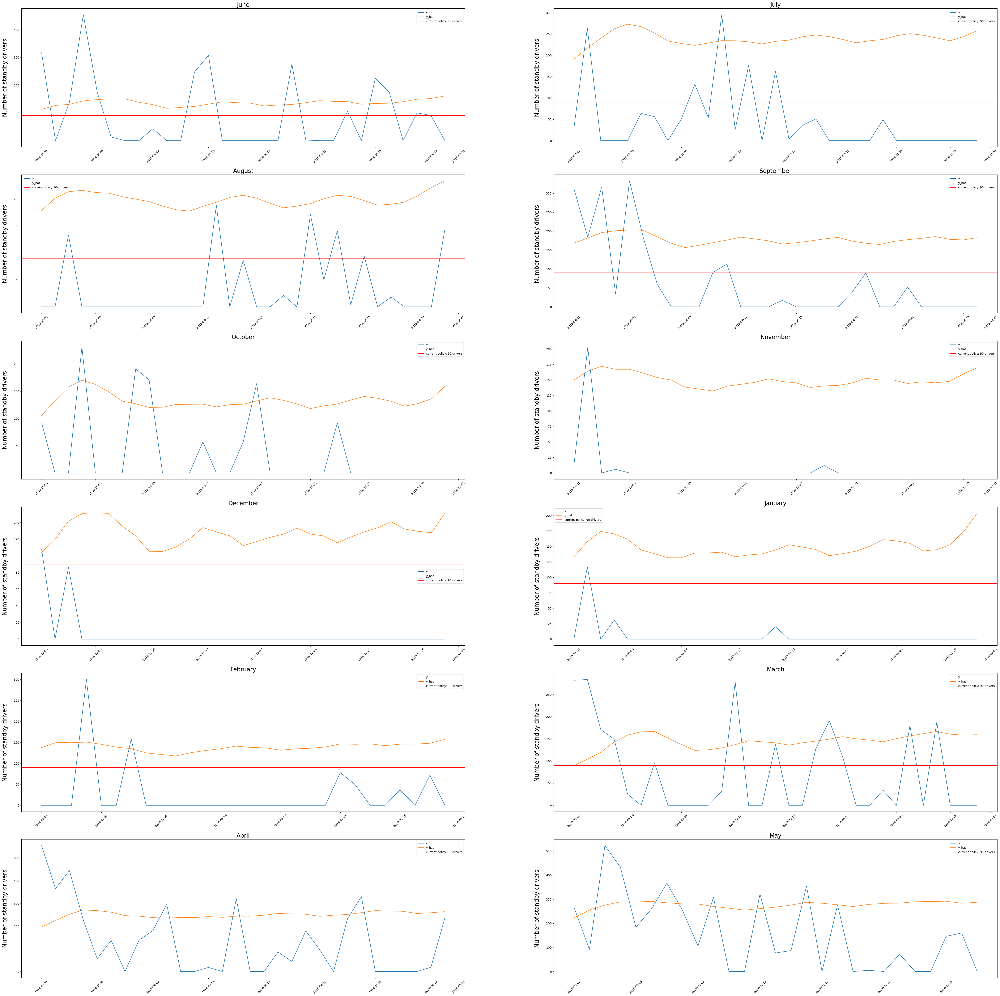

In [21]:
forecaster = TBATS(sp = [365.25, 30.4375, 7],
                  use_box_cox = False,
                  use_trend = False,
                  use_damped_trend = False,
                  use_arma_errors = False,
                  n_jobs = -1)
                    
cv_sktime_models_one_year(model = forecaster, 
         statsforecast_df = data, 
         splits_dict = year_split, 
         custom_scorer = interpretable_scores,
                        transformer = None,
                          smoothing = "MA_oneday",
                          interval = 0.7,
                         plotting = True) 

Please note the performance of the above model, as I will be referring to it in the future.
While its efficiency is worse than the 90 driver policy, it is able to reduce the number of days on which additional drivers have to be recruited from their days off. 
This is testament of the model simply overpredicting most of the time, thereby having high safety margins in the predicted number of sby drivers needed on a given day which leads to the the model being able to buffer high sby driver requirements.

Also, please note the next cell, in which I used the same model parameters in terms of smoothing and prediction interval settings, but allowed the algorithm to incorporate box-cox transformations as well as trend, damped trend and ARMA error modelling. 
Importantly, it performs worse in the second business metric.


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -0.07011415204539162
Number of additional underpredictions = 0
Number of additional sby drivers required = 15.293839183704307

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 1.3432976152709166
Number of additional underpredictions = 0
Number of additional sby drivers required = -4.899877833880055

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 3.591999980540489
Number of additional underpredictions = -3
Number of additional sby drivers required = -13.534466284632025

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 0.8925502352658299
Number of additional underpredictions = 1
Number of additional sby drivers required = -36.58318477876851

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -0.8504108874482448
Number of additional underpredi

,regressors,y_pred_list,efficiency_losses,num_undershoots,magnitude_undershoots
0,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[86.45400229422482, 101.74643188522026, 109.59...",-0.070114,0,15.293839
1,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[89.73948697603663, 111.5791303713289, 131.691...",1.343298,0,-4.899878
2,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[131.702614162276, 157.0733923244877, 168.5990...",3.592000,-3,-13.534466
3,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[102.48865075989605, 113.42469765941033, 129.9...",0.892550,1,-36.583185
4,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[91.87105527081204, 114.2844335822501, 134.784...",-0.850411,0,0.940384
5,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[90.98285477425696, 103.7789326754885, 111.116...",-0.473046,0,-13.778933
6,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[64.17000764402167, 76.90909846946559, 96.2959...",0.201532,0,25.829992
7,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[78.70813098587949, 101.29752703132507, 118.46...",0.015754,0,-11.297527
8,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[97.91760222604577, 109.17004794202954, 108.10...",-1.952082,1,-50.085605
9,"TBATS(n_jobs=-1, sp=[365.25, 30.4375, 7], use_...","[72.02766225555936, 84.82400647539754, 97.7383...",0.991657,-1,5.979762


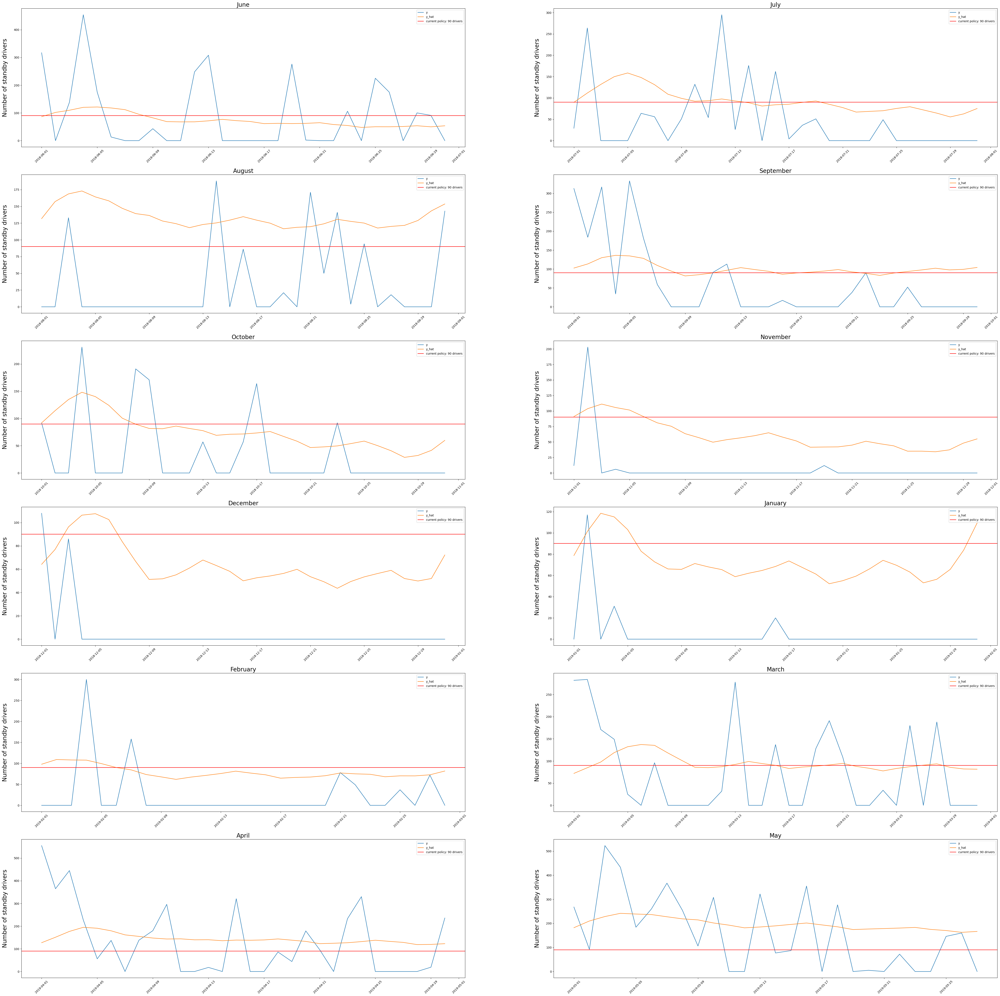

In [22]:
forecaster = TBATS(sp = [365.25, 30.4375, 7],
                  use_box_cox = None,
                  use_trend = None,
                  use_damped_trend = None,
                  use_arma_errors = None,
                  n_jobs = -1)
                    
cv_sktime_models_one_year(model = forecaster, 
         statsforecast_df = data, 
         splits_dict = year_split, 
         custom_scorer = interpretable_scores,
                        transformer = None,
                          smoothing = "MA_oneday",
                          interval = 0.7,
                         plotting = True) 

The performance of the above tested approaches can be summarized as follows. 

Again, similarly as in the "fixed" naive forecasters above, using MA smoothing as well as predicting the upper bound of prediction intervals lead to improvements in the models' performances in terms of the number of additional days on which drivers would have to be recruited from their days off.
However, again, this worsened the efficiency metric. 

While using the smoothing and prediction interval approach allows us to improve the second business goal of reducing the amount of times additional drivers have to be recruited from their days off, logically, it simultaneously worsens the efficiency metric when the model is overpredicting most of the time just to buffer the rather rare events that are the days on which drivers are actually required. 

Optimally, it would be desired to prevent those rather rare events by only providing such a buffering system on days on which it is more likely that those events would occur. 
Thereby, the costs associated with providing such buffers, manifesting themselves in the reduction in efficiency due to overpredictions, would be minimized. 

Thus, in the following, efforts were undertaken to establish a pipeline in which a classifier is implemented upstream of the regressor.
The idea was that the classifier would predict the probability of nonzero driver requirements first, after which a regressor would subsequently predict the actual number of driver needed in case the probability of the classifier would be higher than a prespecified decision threshold (similarly to zero-inflated Poisson regression).
Conversely, if the probability would be lower than the threshold, the predictions for the number of drivers needed would be set to zero. 

Thus, when using a regressor predicting a large safety margin, it would be possible to provide a buffer for the driver needs on days where nonzero driver demands are likely.
Simultaneously, the efficiency of the model could be increased by rightfully predicting zero sby drivers on days on which the classifier successfully predicted the absence of driver requirements. 

The story continues in the "EBC_optimization" notebook.


